<a href="https://colab.research.google.com/github/maryamdarei/CNN-with-ResNet50/blob/main/CNN_with_GRADCAM_herbarium2019_20classes_FinalAdversarialImage.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### CNN Model With PyTorch For Image Classification

### Herbarium DataSet:

Data set is Herbarium Challenge 2019, small data set.

The Herbarium Challenge dataset is a dataset used for plant species recognition, which is a challenging task due to the large number of plant species and the subtle differences in their appearance. This dataset is a long-tail  dataset. A long-tail herbarium dataset refers to a dataset that contains a large number of plant species, but with a highly skewed distribution of instances among the species. This means that the majority of the plant species in the dataset have very few images, while a small number of species have a large number of images.
The long-tail distribution of instances in a dataset can make it challenging to train machine learning models. This is because the model may not have enough data to learn the characteristics of the minority classes, leading to poor performance on those classes. This can also lead to bias in the model's predictions, as it will be more likely to predict the majority classes. To overcome this challenge, several approaches have been proposed such as re-sampling the data, fine-tuning pre-trained models, and using advanced deep learning techniques such as transfer learning and ensembling.

Additionally, there are also recent studies on long-tail datasets that aim to improve the performance on the long-tail classes by generating synthetic data, knowledge distillation, and learning from noisy labels.

Some of the other problems that may arise when working with the Herbarium Challenge dataset include:

1- Limited data availability: The Herbarium Challenge dataset may not contain a sufficient number of images for certain plant species, leading to a lack of diversity in the training data and a higher risk of overfitting.

2- Variations in image quality: The images in the dataset may have different resolutions, lighting conditions, and angles, which can make it difficult for the model to generalize to new images.

3- Label noise: The dataset may contain errors in the labels, which can lead to inaccurate predictions and poor performance.

4- Class imbalance: Some plant species may be over-represented in the dataset, while others may be under-represented, which can lead to bias in the model's predictions.

5- Lack of data augmentation: The dataset may not have undergone data augmentation techniques such as rotation, flipping, and cropping, which can lead to a lack of robustness in the model.

To overcome these challenges, it is important to have a diverse and large dataset with good quality images, carefully curated labels, and data augmentation techniques to increase the robustness of the model. Additionally, using advanced deep learning techniques such as transfer learning and ensembling can also help to improve the performance of the model.

In [21]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).



The classification of herbrium using ResNet50 is a specific task that involves using a deep learning model called ResNet50 to classify different types of herbs. ResNet50 is a pre-trained CNN model that was trained on the ImageNet dataset, which contains a large number of images of various objects and scenes. The model has been trained to extract features from images and classify them into different classes.

In the classification of herbrium using ResNet50, the model is fine-tuned using a dataset of images of herbs. The dataset is likely to contain different types of herbs with different characteristics, such as leaf shape, flower color, and overall appearance. The model is then used to classify new images of herbs based on the features it has learned from the training dataset.

For example, if the model is given an image of a rosemary herb, it would use the features it has learned from the training dataset to recognize the characteristic shape of the leaves and the color of the flowers, and classify the image as "rosemary". Similarly, if the model is given an image of a mint herb, it would recognize the characteristic shape of the leaves and classify the image as "mint".

The classification of herbrium using ResNet50 is likely to be a challenging task due to the subtle differences in appearance between different types of herbs. However, by fine-tuning ResNet50 with a large and diverse dataset of herb images, the model can achieve a high level of accuracy in classifying different types of herbs.


In [2]:
!pip install adversarial-robustness-toolbox


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install grad_cam 

In [3]:
import logging as log
import os
from datetime import datetime

import matplotlib.pyplot as plt
from matplotlib import ticker
from importlib.resources import path
import numpy as np
from PIL import Image

import torch
import torch.nn as nn
import torchvision
from torchvision import transforms
from torchvision import transforms,datasets 
import torchvision.transforms as transforms 
import torch.optim as optim
import torchvision.models as models
import torchvision.transforms as transforms
from torchvision.utils import make_grid
from torch.utils.tensorboard import SummaryWriter

import time 






from art.estimators.classification import PyTorchClassifier
from skimage.metrics import structural_similarity as ssim 

import warnings
warnings.filterwarnings('ignore')



 
 


 
 




 
import sklearn.metrics as skmc  
 
 
 
 
 
 
 
from pytorch_grad_cam import ( 
GradCAM, 
HiResCAM, 
ScoreCAM, 
GradCAMPlusPlus, 
AblationCAM, 
XGradCAM, 
EigenCAM, 
FullGrad, 
) 
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget 
from pytorch_grad_cam.utils.image import show_cam_on_image 
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget 
 
 


 
from art.attacks.evasion import ProjectedGradientDescent 
from art.attacks.evasion import FastGradientMethod 
 





In [5]:
log.basicConfig(format="%(asctime)s %(message)s", level=log.INFO)
log.info("======= starting to log ========")
torch.cuda.empty_cache()

In [4]:
# Define relevant variables for the ML task
num_classes = 20
learning_rate = 0.001
num_epochs = 20  # actual 20 epochs
workers = 0
pin_memory = False
batch_size = 64

In [6]:
# Device will determine whether to run the training on GPU or CPU.
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
if device.type == "cuda":
    deviceid = torch.cuda.current_device()
    log.info(f"Gpu device {torch.cuda.get_device_name(deviceid)}")


# Select the model you want to train

ResNet:

ResNet (Residual Network) is a type of deep neural network that was introduced in 2015 by researchers at Microsoft. The key innovation in ResNet is the use of residual connections, which allow the network to train deeper architectures without suffering from the vanishing gradient problem. Training a ResNet typically involves using stochastic gradient descent (SGD) with backpropagation to optimize the model's parameters with respect to a loss function, such as cross-entropy. This is done by iteratively updating the weights of the network in order to reduce the difference between the predicted output and the true output. Data augmentation techniques such as random cropping and flipping can be used to increase the diversity of the training set and improve the generalization of the model.




In [7]:
modelname = "Res50"

In [8]:

# -------------------------------------------------------------------------------------------------------
# Load the data from image folder
# -------------------------------------------------------------------------------------------------------

data_dir = "/content/drive/MyDrive/Hebarium-Data-2019/Data/sample"
train_dir = os.path.join(data_dir, "train")
normalize_transform = transforms.Normalize(
    mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
)

# I changed the code for resize the image:
train_transforms = transforms.Compose(
    [
        
        transforms.Resize((224,224)),
        transforms.RandomHorizontalFlip(),
        transforms.RandomGrayscale(0.5),
        transforms.ToTensor(),
        normalize_transform,
    ]
)

val_dir = os.path.join(data_dir, "validation")

val_transforms = transforms.Compose(
    [transforms.Resize((277,277)), transforms.ToTensor(), normalize_transform]
)



train_dataset = torchvision.datasets.ImageFolder(train_dir, train_transforms)
val_dataset = torchvision.datasets.ImageFolder(val_dir, val_transforms)


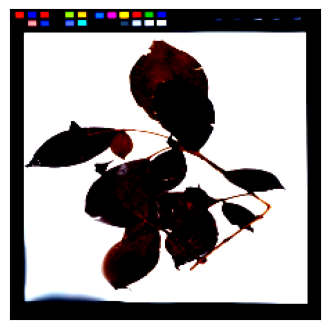

In [9]:
def show_batch(dl):
    """Plot images grid of single batch"""
    for images, labels in dl:
        fig,ax = plt.subplots(figsize = (4,5))
        ax.set_xticks([])
        ax.set_yticks([])
        ax.imshow(make_grid(images,nrow=16).permute(1,2,0))
        break
        
show_batch(train_dataset)


In [ ]:
foldername_to_class = {}
with open('/content/drive/MyDrive/Hebarium-Data-2019/Data/categories.txt', 'r') as file:
    for index, line in enumerate(file):
        if index == 0:
            continue
        else:
            data = line.split(',')
            foldername_to_class[str(int(data[0]))] = data[1].replace('\n', '')

print(foldername_to_class)



# creating a new dictionary
#my_dict ={"java":100, "python":112, "c":11}

 
# list out keys and values separately
key_list = list(foldername_to_class.keys())
val_list = list(foldername_to_class.values())
 
print(key_list)
print(val_list)
#print key with val 100
#position = val_list.index("Siphanthera cordata Pohl ex DC.")
print(key_list[val_list.index("Siphanthera cordata Pohl ex DC.")])
        

In [ ]:
# sort as value to fit the directory order to labels to be sure
print("Image to Folder Index", train_dataset.class_to_idx.items())
sorted_vals = dict(sorted(train_dataset.class_to_idx.items(), key=lambda item: item[1]))

categories = []
for key in sorted_vals:
    print(key)
    classname = foldername_to_class[key]
    categories.append(classname)

log.info(f"Categories {categories}")

In [12]:
# -------------------------------------------------------------------------------------------------------
# Initialise the data loaders
# -------------------------------------------------------------------------------------------------------

# ImageFile.LOAD_TRUNCATED_IMAGES = True # Use the data_checker.py and remove bad files instead of using this

train_loader = torch.utils.data.DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=True,  # IMPORTANT otherwise the data is not shuffled
    num_workers=workers,
    pin_memory=pin_memory,
    sampler=None,
)

test_loader = torch.utils.data.DataLoader(
    val_dataset,
    batch_size=batch_size,
    shuffle=False,
    num_workers=workers,
    pin_memory=pin_memory,
)


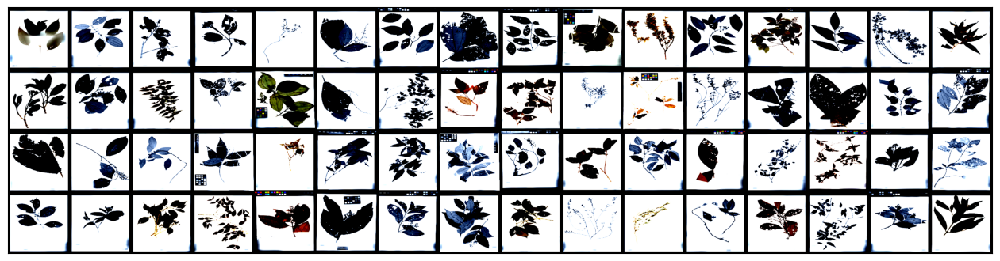

In [13]:
def show_batch(dl):
    """Plot images grid of single batch"""
    for images, labels in dl:
        fig,ax = plt.subplots(figsize = (16,20))
        ax.set_xticks([])
        ax.set_yticks([])
        ax.imshow(make_grid(images,nrow=16).permute(1,2,0))
        break
        
show_batch(train_loader)


In [ ]:
#I added this line for running the model:
model = torchvision.models.resnet50()
model.to(device)


In [15]:

# initialize our optimizer and loss function
opt = torch.optim.Adam(model.parameters(), lr=learning_rate)
lossFn = nn.CrossEntropyLoss()


## Train Model:

Training a CNN with ResNet involves several steps:

Prepare the dataset: This includes loading the images and labels, preprocessing the data (e.g. resizing, normalizing), and splitting the data into training and validation sets.

Load the ResNet model: This can be done using a library such as Keras or PyTorch, which provide pre-trained ResNet models that can be easily loaded and used for transfer learning.

Freeze the layers: Since ResNet is pre-trained on a large dataset, the initial layers of the model contain valuable features that can be used for the new task. So it's often a good idea to freeze the initial layers of the model and only train the last few layers, which are randomly initialized.

Compile the model: This step involves specifying the optimizer, loss function, and metrics that will be used to train the model.

Train the model: This involves passing the training data through the model, updating the model's parameters based on the loss function, and repeating this process for a number of epochs.

Validate the model: After training, the model is evaluated on a validation dataset to estimate its performance on unseen data.

Fine-tune the model: Based on the validation results, you can adjust the model's architecture, hyperparameters, or the data preprocessing steps to improve its performance.

Test the model: Finally, the model is evaluated on a test dataset to get a final estimate of its performance on unseen data.

It's important to note that training deep neural networks like ResNet can be computationally expensive and time-consuming. It's also important to have a good balance of dataset to avoid overfitting.

In [16]:

# -------------------------------------------------------------------------------------------------------
# Train the model
# -------------------------------------------------------------------------------------------------------

for images, labels in train_loader:
    log.info(f"Shape of X [N, C, H, W]: {images.shape}")
    log.info(f"Shape of y: {labels.shape} {labels.dtype}")
    # test one flow
    # pred = model(x)
    # loss = lossFn(pred, y)
    break
total_step = len(train_loader)
log.info(f"Total steps: {total_step}")

stepsize = total_step // 100
if stepsize < 10:
    stepsize = 10


In [17]:

# Write training matrics to Tensorboard
writer = SummaryWriter()

# loop over our epochs
for epoch in range(0, num_epochs):
    # set the model in training mode
    model.train()  # IMPORTANT otherwise the model is not in training mode
    # initialize the total training and validation loss
    totalTrainLoss = 0
    totalValLoss = 0
    # initialize the number of correct predictions in the training
    # and validation step
    trainAccuracy = 0
    totalTrainAccuracy = 0
    valCorrect = 0

    # loop over the training set
    for i, (images, labels) in enumerate(train_loader):

        try:
            # Train in auto-mode with 16 bit mode
            # with torch.autocast(device_type='cuda', dtype=torch.float16):
            # Train in normal mode
            with torch.autocast(device_type="cuda", dtype=torch.float32):
                # send the input to the device
                (images, labels) = (images.to(device), labels.to(device))
                # perform a forward pass and calculate the training loss
                outputs = model(images)
                # output is float16 because linear layers autocast to float16.
                # assert outputs.dtype is torch.float16 or 64

                loss = lossFn(outputs, labels)
                # zero out the gradients, perform the backpropagation step,
                # and update the weights
                writer.add_scalar("Loss/train", loss,  (epoch * total_step)+(i+1))
                opt.zero_grad()  # IMPORTANT otherwise the gradients of previous batches are not zeroed out
        except Exception as e:
            log.error(f"Exception in data processing- skip and continue = {e}")
        loss.backward()
        totalTrainLoss += loss
        opt.step()
        # Get the predicted values
        _, predicted = torch.max(outputs.data, 1)
        trainAccuracy = (predicted == labels).float().sum().item()
        trainAccuracy = 100 * trainAccuracy / labels.size(0)
        writer.add_scalar("Accuracy/train", trainAccuracy,(epoch * total_step)+(i+1))
        totalTrainAccuracy += trainAccuracy
        # if (i // stepsize) % 10 == 0:
        log.info(
            "Epoch [{}/{}], Step [{}/{}], Loss: {:.4f} Accuracy: {:.4f}".format(
                epoch + 1, num_epochs, i + 1, total_step, loss, trainAccuracy
            )
        )

    

    avgTrainLoss = totalTrainLoss / len(train_loader)
    avgAccuracy = totalTrainAccuracy / len(train_loader)
    log.info(
        "--->Epoch [{}/{}], Average Loss: {:.4f} Average Accuracy: {:.4f}".format(
            epoch + 1, num_epochs, avgTrainLoss, avgAccuracy
        )
    )

    print('Epoch [{}/{}], Loss: {:.4f}, TrainAccuracy: {:.4f} '.format(epoch+1, num_epochs, loss, trainAccuracy))

    # End Epoch loop
writer.flush()



Epoch [1/20], Loss: 1.1039, TrainAccuracy: 66.6667 
Epoch [2/20], Loss: 4.0728, TrainAccuracy: 0.0000 
Epoch [3/20], Loss: 6.4456, TrainAccuracy: 0.0000 
Epoch [4/20], Loss: 5.1409, TrainAccuracy: 0.0000 
Epoch [5/20], Loss: 2.7808, TrainAccuracy: 33.3333 
Epoch [6/20], Loss: 3.5451, TrainAccuracy: 0.0000 
Epoch [7/20], Loss: 1.8973, TrainAccuracy: 33.3333 
Epoch [8/20], Loss: 1.1820, TrainAccuracy: 33.3333 
Epoch [9/20], Loss: 0.9426, TrainAccuracy: 66.6667 
Epoch [10/20], Loss: 1.5509, TrainAccuracy: 0.0000 
Epoch [11/20], Loss: 3.5470, TrainAccuracy: 0.0000 
Epoch [12/20], Loss: 1.1511, TrainAccuracy: 33.3333 
Epoch [13/20], Loss: 1.7886, TrainAccuracy: 66.6667 
Epoch [14/20], Loss: 0.3042, TrainAccuracy: 100.0000 
Epoch [15/20], Loss: 0.4912, TrainAccuracy: 100.0000 
Epoch [16/20], Loss: 0.7755, TrainAccuracy: 33.3333 
Epoch [17/20], Loss: 1.8358, TrainAccuracy: 0.0000 
Epoch [18/20], Loss: 0.4866, TrainAccuracy: 66.6667 
Epoch [19/20], Loss: 2.3786, TrainAccuracy: 33.3333 
Epoch [

In [18]:
with torch.no_grad():
    correct = 0
    total = 0
    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    print('Accuracy of the network on the {} validation images: {} %'.format(19, 100 * correct / total))
    print(labels)
    print(predicted)

Accuracy of the network on the 19 validation images: 28.88888888888889 %
tensor([14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 15, 15, 15, 16, 16, 16, 16,
        16, 17, 17, 17, 18, 18, 19, 19], device='cuda:0')
tensor([ 8,  2,  2, 14, 12, 14, 11, 11, 14,  8,  2, 15, 16, 16,  2, 14,  1, 14,
        10,  2,  8, 17, 10, 10, 16, 10], device='cuda:0')


## Test and Analyse the Model

Testing a CNN model with ResNet50 would involve using a dataset of images that the model has not seen during training. The goal of testing is to evaluate the model's performance on unseen data and to estimate its generalization error.

To test a CNN model with ResNet50, you would first need to load the pre-trained weights of the model. This can be done using a library such as PyTorch, which provide pre-trained ResNet50 models that can be easily loaded and used for testing.

Once the model is loaded, you would need to prepare your test dataset by preprocessing the images (e.g. resizing, normalizing) and labels in the same way as the training dataset. Then, you can use the model to make predictions on the test dataset by passing the images through the model and comparing the model's predictions to the true labels.


In [20]:
# Save the model
#/content/drive/MyDrive/Herbarium Data-2019/SavedModel
modelname ="resnet50"
path = "/content/drive/MyDrive/Hebarium-Data-2019/SavedModel"
model_save_name = path + modelname + datetime.now().strftime("%H:%M_%B%d%Y")
torch.save(model.state_dict(), model_save_name + ".pth")
log.info(f"Model {modelname} saved as {model_save_name}")


# Analyse Model:

A confusion matrix is a table that is often used to evaluate the performance of a classifier, such as a CNN. The matrix is used to compare the predicted class labels with the true class labels of the test set. The rows of the matrix represent the true class labels, while the columns represent the predicted class labels.


The confusion matrix allows you to see which classes the model is confused between, and can give you a better understanding of the performance of your model. From the matrix, you can also calculate some performance metrics such as accuracy, precision, recall, and F1-score.

We use a confusion matrix to evaluate the model's performance. It shows the number of times each class was predicted as another class, and provides a visual representation of the model's accuracy and errors.

## Confusion Matrix for training Data:

In [21]:
# Generate the Confusion Matrix

print('Training Analyse:')
print('\n')


confusion_matrix = np.zeros((len(categories), len(categories)))

# In test phase, we don't need to compute gradients (for memory efficiency)
with torch.no_grad():
    model.eval()  # IMPORTANT set model to eval mode before inference

    for images, labels in train_loader:
        images = images.to(device)
        labels = labels.to(device)

        # ------------------------------------------------------------------------------------------
        # Predict for the batch of images
        # ------------------------------------------------------------------------------------------
        outputs = model(
            images
        )  # Outputs= torch.Size([64, 10]) Probability of each of the 10 classes
        _, predicted = torch.max(
            outputs.data, 1
        )  # get the class with the highest Probability out Given 1 per image # predicted= torch.Size([64])
        # ------------------------------------------------------------------------------------------
        #  Lets check also which classes are wrongly predicted with other classes  to create a MultiClass confusion matrix
        # ------------------------------------------------------------------------------------------

        mask = predicted != labels  # Wrongly predicted
        wrong_predicted = torch.masked_select(predicted, mask)
        wrong_labels = torch.masked_select(labels, mask)
        wrongly_zipped = zip(wrong_labels, wrong_predicted)


        mask = predicted == labels  # Rightly predicted
        rightly_predicted = torch.masked_select(predicted, mask)
        right_labels = rightly_predicted  # same torch.masked_select(labels,mask)
        rightly_zipped = zip(right_labels, rightly_predicted)

        # Note that this is for a single batch - add to the list associated with class
        for _, j in enumerate(wrongly_zipped):
            k = j[0].item()  # label
            l = j[1].item()  # predicted
            confusion_matrix[k][l] += 1

        # Note that this is for a single batch - add to the list associated with class
        for _, j in enumerate(rightly_zipped):
            k = j[0].item()  # label
            l = j[1].item()  # predicted
            confusion_matrix[k][l] += 1

    # print("Confusion Matrix1=\n",confusion_matrix)
    # ------------------------------------------------------------------------------------------
    # Print Confusion matrix in Pretty print format
    # ------------------------------------------------------------------------------------------
    #print(categories)
    for i in range(len(categories)):
        for j in range(len(categories)):
            print(f"\t{confusion_matrix[i][j]}", end="")
        print(f"\t{categories[i]}\n", end="")
    # ------------------------------------------------------------------------------------------
    # Calculate Accuracy per class
    # ------------------------------------------------------------------------------------------
    print("---------------------------------------")
    print(
        f"Accuracy/precision from confusion matrix from training is {round(confusion_matrix.trace()/confusion_matrix.sum(),2)}"
    )
    print("---------------------------------------")
    for i in range(len(categories)):
        print(
            f"---Accuracy for class {categories[i]} = {round(confusion_matrix[i][i]/confusion_matrix[i].sum(),2)}"
        )
print('\n')
print('\n')

print('Testing Analyse:')
print('\n')





# Generate the Confusion Matrix

confusion_matrix = np.zeros((len(categories), len(categories)))

# In test phase, we don't need to compute gradients (for memory efficiency)
with torch.no_grad():
    model.eval()  # IMPORTANT set model to eval mode before inference

    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)

        # ------------------------------------------------------------------------------------------
        # Predict for the batch of images
        # ------------------------------------------------------------------------------------------
        outputs = model(
            images
        )  # Outputs= torch.Size([64, 10]) Probability of each of the 10 classes
        _, predicted = torch.max(
            outputs.data, 1
        )  # get the class with the highest Probability out Given 1 per image # predicted= torch.Size([64])
        # ------------------------------------------------------------------------------------------
        #  Lets check also which classes are wrongly predicted with other classes  to create a MultiClass confusion matrix
        # ------------------------------------------------------------------------------------------

        mask = predicted != labels  # Wrongly predicted
        wrong_predicted = torch.masked_select(predicted, mask)
        wrong_labels = torch.masked_select(labels, mask)
        wrongly_zipped = zip(wrong_labels, wrong_predicted)

        mask = predicted == labels  # Rightly predicted
        rightly_predicted = torch.masked_select(predicted, mask)
        right_labels = rightly_predicted  # same torch.masked_select(labels,mask)
        rightly_zipped = zip(right_labels, rightly_predicted)

        # Note that this is for a single batch - add to the list associated with class
        for _, j in enumerate(wrongly_zipped):
            k = j[0].item()  # label
            l = j[1].item()  # predicted
            confusion_matrix[k][l] += 1

        # Note that this is for a single batch - add to the list associated with class
        for _, j in enumerate(rightly_zipped):
            k = j[0].item()  # label
            l = j[1].item()  # predicted
            confusion_matrix[k][l] += 1

    # print("Confusion Matrix1=\n",confusion_matrix)
    # ------------------------------------------------------------------------------------------
    # Print Confusion matrix in Pretty print format
    # ------------------------------------------------------------------------------------------
    #print(categories)
    for i in range(len(categories)):
        for j in range(len(categories)):
            print(f"\t{confusion_matrix[i][j]}", end="")
        print(f"\t{categories[i]}\n", end="")
    # ------------------------------------------------------------------------------------------
    # Calculate Accuracy per class
    # ------------------------------------------------------------------------------------------
    print("---------------------------------------")
    print(
        f"Accuracy/precision from confusion matrix for testing is {round(confusion_matrix.trace()/confusion_matrix.sum(),2)}"
    )
    print("---------------------------------------")
    for i in range(len(categories)):
        print(
            f"---Accuracy for class {categories[i]} = {round(confusion_matrix[i][i]/confusion_matrix[i].sum(),2)}"
        )


Training Analyse:


	14.0	1.0	1.0	0.0	0.0	0.0	0.0	0.0	1.0	0.0	1.0	0.0	0.0	0.0	0.0	0.0	0.0	0.0	0.0	0.0	Miconia approximata Gamba & Almeda
	0.0	143.0	10.0	0.0	0.0	0.0	0.0	0.0	16.0	0.0	10.0	0.0	25.0	5.0	8.0	0.0	5.0	12.0	5.0	0.0	Miconia ibaguensis (Bonpl.) Triana
	0.0	7.0	40.0	0.0	8.0	0.0	0.0	0.0	3.0	0.0	4.0	0.0	8.0	0.0	8.0	1.0	0.0	1.0	2.0	0.0	Clidemia bullosa DC.
	13.0	0.0	0.0	1.0	0.0	0.0	0.0	0.0	0.0	0.0	1.0	0.0	1.0	0.0	0.0	0.0	0.0	0.0	0.0	0.0	Mouriri sagotiana Triana
	0.0	2.0	9.0	0.0	34.0	0.0	0.0	0.0	0.0	0.0	0.0	0.0	2.0	0.0	0.0	0.0	0.0	0.0	0.0	0.0	Blakea henripittieri (Cogn.) Penneys & Almeda
	0.0	0.0	0.0	0.0	2.0	3.0	0.0	0.0	2.0	0.0	2.0	2.0	9.0	0.0	2.0	0.0	0.0	0.0	0.0	0.0	Clidemia debilis Crueg.
	0.0	0.0	0.0	0.0	0.0	0.0	0.0	0.0	0.0	0.0	1.0	0.0	0.0	0.0	0.0	20.0	1.0	0.0	0.0	0.0	Comolia veronicaefolia Benth.
	0.0	0.0	0.0	0.0	0.0	0.0	0.0	65.0	0.0	0.0	4.0	0.0	0.0	0.0	0.0	1.0	0.0	0.0	1.0	0.0	Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
	0.0	2.0	0.0	0.0	0.0	0.0	0.0	0.0	121.0	0.0	0.0	0.

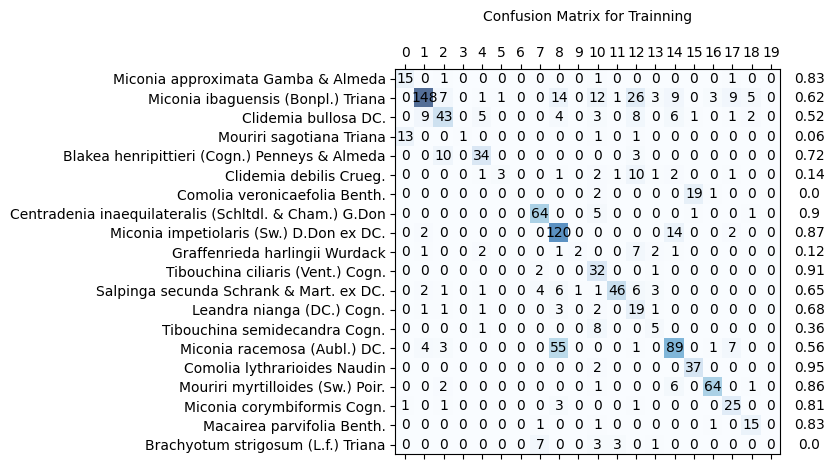

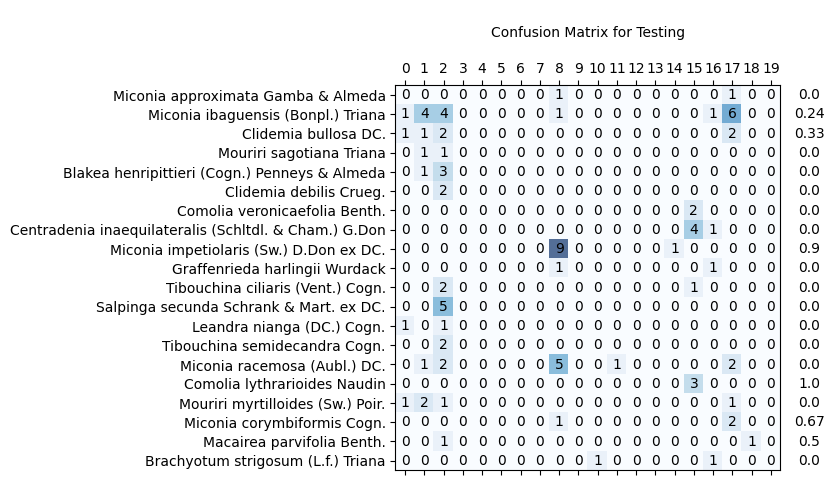

In [22]:
# Generate the Confusion Matrix

confusion_matrix = np.zeros((len(categories), len(categories)))

# In test phase, we don't need to compute gradients (for memory efficiency)
with torch.no_grad():
    model.eval()  # IMPORTANT set model to eval mode before inference

    for images, labels in train_loader:
        images = images.to(device)
        labels = labels.to(device)

        # ------------------------------------------------------------------------------------------
        # Predict for the batch of images
        # ------------------------------------------------------------------------------------------
        outputs = model(
            images
        )  # Outputs= torch.Size([64, 10]) Probability of each of the 10 classes
        _, predicted = torch.max(
            outputs.data, 1
        )  # get the class with the highest Probability out Given 1 per image # predicted= torch.Size([64])
        # ------------------------------------------------------------------------------------------
        #  Lets check also which classes are wrongly predicted with other classes  to create a MultiClass confusion matrix
        # ------------------------------------------------------------------------------------------

        mask = predicted != labels  # Wrongly predicted
        wrong_predicted = torch.masked_select(predicted, mask)
        wrong_labels = torch.masked_select(labels, mask)
        wrongly_zipped = zip(wrong_labels, wrong_predicted)

        mask = predicted == labels  # Rightly predicted
        rightly_predicted = torch.masked_select(predicted, mask)
        right_labels = rightly_predicted  # same torch.masked_select(labels,mask)
        rightly_zipped = zip(right_labels, rightly_predicted)

        # Note that this is for a single batch - add to the list associated with class
        for _, j in enumerate(wrongly_zipped):
            k = j[0].item()  # label
            l = j[1].item()  # predicted
            confusion_matrix[k][l] += 1

        # Note that this is for a single batch - add to the list associated with class
        for _, j in enumerate(rightly_zipped):
            k = j[0].item()  # label
            l = j[1].item()  # predicted
            confusion_matrix[k][l] += 1


    fig = plt.figure(figsize=(5,5))
    ax = fig.add_subplot(111)
    plt.title("Confusion Matrix for Trainning\n", fontsize=10)
    ax.matshow(confusion_matrix, cmap=plt.cm.Blues, alpha=0.7)
    #ax.set_xticklabels([""] + categories, rotation=90)
    ax.set_yticklabels([""] + categories)
    ax.xaxis.set_major_locator(ticker.MultipleLocator(1))
    ax.yaxis.set_major_locator(ticker.MultipleLocator(1))
    for i in range(confusion_matrix.shape[0]):
        for j in range(confusion_matrix.shape[1]):
            ax.text(
                x=j,
                y=i,
                s=int(confusion_matrix[i, j]),
                va="center",
                ha="center",
                size="medium",
            )
            if i == j:
                acc = round(confusion_matrix[i][i] / confusion_matrix[i].sum(), 2)
                ax.text(
                    x=len(categories) + 1,
                    y=i,
                    s=acc,
                    va="center",
                    ha="center",
                    size="medium",
                )
    plt.savefig(model_save_name + "_cm.jpg")


# Generate the Confusion Matrix





confusion_matrix = np.zeros((len(categories), len(categories)))

# In test phase, we don't need to compute gradients (for memory efficiency)
with torch.no_grad():
    model.eval()  # IMPORTANT set model to eval mode before inference

    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)

        # ------------------------------------------------------------------------------------------
        # Predict for the batch of images
        # ------------------------------------------------------------------------------------------
        outputs = model(
            images
        )  # Outputs= torch.Size([64, 10]) Probability of each of the 10 classes
        _, predicted = torch.max(
            outputs.data, 1
        )  # get the class with the highest Probability out Given 1 per image # predicted= torch.Size([64])
        # ------------------------------------------------------------------------------------------
        #  Lets check also which classes are wrongly predicted with other classes  to create a MultiClass confusion matrix
        # ------------------------------------------------------------------------------------------

        mask = predicted != labels  # Wrongly predicted
        wrong_predicted = torch.masked_select(predicted, mask)
        wrong_labels = torch.masked_select(labels, mask)
        wrongly_zipped = zip(wrong_labels, wrong_predicted)

        mask = predicted == labels  # Rightly predicted
        rightly_predicted = torch.masked_select(predicted, mask)
        right_labels = rightly_predicted  # same torch.masked_select(labels,mask)
        rightly_zipped = zip(right_labels, rightly_predicted)

        # Note that this is for a single batch - add to the list associated with class
        for _, j in enumerate(wrongly_zipped):
            k = j[0].item()  # label
            l = j[1].item()  # predicted
            confusion_matrix[k][l] += 1

        # Note that this is for a single batch - add to the list associated with class
        for _, j in enumerate(rightly_zipped):
            k = j[0].item()  # label
            l = j[1].item()  # predicted
            confusion_matrix[k][l] += 1

  
    
    fig = plt.figure(figsize=(5,5))
    ax = fig.add_subplot(111)
    plt.title("\nConfusion Matrix for Testing\n", fontsize=10)
    ax.matshow(confusion_matrix, cmap=plt.cm.Blues, alpha=0.7)
    #ax.set_xticklabels([""] + categories, rotation=90)
    ax.set_yticklabels([""] + categories)
    ax.xaxis.set_major_locator(ticker.MultipleLocator(1))
    ax.yaxis.set_major_locator(ticker.MultipleLocator(1))
    for i in range(confusion_matrix.shape[0]):
        for j in range(confusion_matrix.shape[1]):
            ax.text(
                x=j,
                y=i,
                s=int(confusion_matrix[i, j]),
                va="center",
                ha="center",
                size="medium",
            )
            if i == j:
                acc = round(confusion_matrix[i][i] / confusion_matrix[i].sum(), 2)
                ax.text(
                    x=len(categories) + 1,
                    y=i,
                    s=acc,
                    va="center",
                    ha="center",
                    size="medium",
                )          
    plt.savefig(model_save_name + "_cm.jpg")





## Predict a score for each class label

In this process, a set of images is used to evaluate the performance of a pre-trained CNN model. The model uses its learned features to analyze each image and predict the class label that it believes the image belongs to. For each image, the model generates a score for each class label, indicating the likelihood that the image belongs to that class. The class label with the highest score is considered the model's prediction for that image. Additionally, the class label with the lowest score can give an insight into the classes that the model is certain the image does not belong to.

For example, if the model is trained to recognize different types of animals, and it is given an image of a dog, the model will generate scores for different class labels such as "dog", "cat", "horse", "bird", etc. The class label "dog" might have the highest score (e.g. 0.95) indicating that the model is very confident that the image is of a dog. The class label "cat" might have a lower score (e.g. 0.05) indicating that the model is certain that the image is not of a cat.

This scoreboard of predictions along with the technique called GradCAM (Gradient-weighted Class Activation Mapping) can help us understand how the model arrived at its predictions. GradCAM is a technique that allows us to visualize which parts of an image the model is focusing on when making its predictions. For example, if the model is given an image of a dog, the GradCAM visualization might show that the model is focusing on the eyes, ears and nose of the dog, which are known to be key features for identifying dogs.


By analyzing the predictions, scores and GradCAM, we can evaluate the model's performance, identify potential areas for improvement, and gain a better understanding of how the model interprets images and makes predictions.






In [23]:
model = model.eval()

In [24]:
with torch.no_grad():
    correct = 0
    total = 0
    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    print('Accuracy of the network on the {} validation images: {} %'.format(19, 100 * correct / total))
    print(labels)
    print(predicted)

Accuracy of the network on the 19 validation images: 23.333333333333332 %
tensor([14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 15, 15, 15, 16, 16, 16, 16,
        16, 17, 17, 17, 18, 18, 19, 19], device='cuda:0')
tensor([ 8,  8,  2,  1,  8,  8, 11, 17,  2,  8, 17, 15, 15, 15,  2,  1,  1,  0,
        17, 17,  8, 17,  2, 18, 16, 10], device='cuda:0')


In [26]:

#path = "cnn/saved_models/" +path
resize_to = transforms.Resize((227, 227))
#model.load_state_dict(torch.load(path))
model.eval()
directory = '/content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation'

# use os.listdir() to get a list of all files in the directory
files = os.listdir(directory)
for filename in files:
  #print(filename)
  img_files = os.listdir('/content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation/'+filename)
  for img_file in img_files:
    
    input_image = Image.open('/content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation/'+filename+"/"+img_file)
    preprocess = transforms.Compose(
          [
              resize_to,
              transforms.ToTensor(),
              transforms.Normalize(
                  mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
              ),  # IMPORTANT: normalize for pretrained models
          ]
    )
    input_tensor = preprocess(input_image)
    input_batch = input_tensor.unsqueeze(0)  # create a mini-batch as expected by the model

    # move the input and model to GPU for speed if available
    if torch.cuda.is_available():
      input_batch = input_batch.to("cuda")
      model.to("cuda")

    with torch.no_grad():
        output = model(input_batch)
    # The output has unnormalized scores. To get probabilities, you can run a softmax on it.
    probabilities = torch.nn.functional.softmax(output[0], dim=0)
    # print(probabilities)
    x , y = torch.topk(probabilities, 1) 
    #print(categories[y])
    print("real class name: ", foldername_to_class[str(filename)])
    print(f"image {img_file} Detecting for class {categories[y]} by model {modelname}")
    #print(f"Detecting for class {img_file + foldername_to_class[str(filename)} +  model {modelname}")
    print("--")
    # Show top categories per image
    top5_prob, top5_catid = torch.topk(probabilities, 20)
    #top1_prob, top1_catid = torch.topk(probabilities, )
    #print(categories[top1_catid[i]])
    for i in range(top5_prob.size(0)):
        print(categories[top5_catid[i]], top5_prob[i].item())
    print("--------------------------------")

real class name:  Miconia approximata Gamba & Almeda
image 00000.jpg Detecting for class Miconia approximata Gamba & Almeda by model resnet50
--
Miconia approximata Gamba & Almeda 0.5848900675773621
Miconia corymbiformis Cogn. 0.3857998549938202
Clidemia bullosa DC. 0.014445386826992035
Mouriri sagotiana Triana 0.00775849400088191
Miconia impetiolaris (Sw.) D.Don ex DC. 0.004883193410933018
Miconia ibaguensis (Bonpl.) Triana 0.0017173626692965627
Leandra nianga (DC.) Cogn. 0.00037562072975561023
Miconia racemosa (Aubl.) DC. 9.305514686275274e-05
Salpinga secunda Schrank & Mart. ex DC. 1.5713632819824852e-05
Blakea henripittieri (Cogn.) Penneys & Almeda 1.543706275697332e-05
Graffenrieda harlingii Wurdack 3.80258302357106e-06
Mouriri myrtilloides (Sw.) Poir. 1.2642649380723014e-06
Macairea parvifolia Benth. 3.77024861109021e-07
Brachyotum strigosum (L.f.) Triana 2.448812495003949e-07
Clidemia debilis Crueg. 1.545527439361649e-08
Comolia veronicaefolia Benth. 7.0991110767693044e-09
Comol

**Utility to check Precision and Recall of a  trained model Author - Alex Punnen**

In [ ]:
log.basicConfig(format="%(asctime)s %(message)s", level=log.INFO)
torch.cuda.empty_cache()

## Analyse Model:
***Model Explain-ability GradCam***
Gradcam helps one visualize which parts of the images are important for the CNN when it classifies an object with high probability. After testing a model, you can use this to visualize and debug the test results.



Gradient-weighted Class Activation Mapping (***Grad-CAM***) is a technique for visualizing the regions in an image that are most important for a given classification decision made by a Convolutional Neural Network (CNN). Grad-CAM uses the gradients of the final convolutional layer of a CNN to generate a heatmap, which highlights the regions of the input image that have the strongest influence on the classification decision, however I use the gradients of all convolutional layer of a ResNet to generate a heatmap.

One of the key advantages of Grad-CAM is that it can be applied to any CNN architecture, regardless of the number of layers or the specific architecture used. Additionally, Grad-CAM can be used to generate visual explanations for any class in the dataset, rather than just the top-scoring class.

In summary, Grad-CAM is a technique that can be used to understand the internal workings of a CNN by visualizing the regions of an image that are most important for a given classification decision. It works by using the gradients of the final convolutional layer to generate a heatmap, which highlights the regions of the input image that have the strongest influence on the classification decision.


In [27]:

def flatten_model(modules):
    def flatten_list(_2d_list):
        flat_list = []
        # Iterate through the outer list
        for element in _2d_list:
            if type(element) is list:
                # If the element is of type list, iterate through the sublist
                for item in element:
                    flat_list.append(item)
            else:
                flat_list.append(element)
        return flat_list

    ret = []
    try:
        for _, n in modules:
            ret.append(loopthrough(n))
    except:
        try:
            if str(modules._modules.items()) == "odict_items([])":
                ret.append(modules)
            else:
                for _, n in modules._modules.items():
                    ret.append(loopthrough(n))
        except:
            ret.append(modules)
    return flatten_list(ret)

## Set the target for the CAM layer:

To generate a Class Activation Map (CAM), you typically use the output of the last fully connected layer of your model as the input to the CAM layer. This output represents the class scores for the input image, and the CAM layer generates a heatmap highlighting the regions of the image that are most important for the model's classification decision.

However, when we use a pre-trained model such as ResNet50, the architecture is more complex and has multiple layers. In this case, to create a Grad-CAM, which is a variant of CAM, we add all the ResNet50 layers to the model, including convolutional and pooling layers, in order to compute the gradients of the last convolutional layer with respect to the output of the fully connected layer. Then, the gradients are used to weight the feature maps from the last convolutional layer and generate the CAM heatmap.


In [ ]:
# Set the target for the CAM layer; Add all the layers in the model
target_layers =[]
module_list =[module for module in model.modules()]


flatted_list= flatten_model(module_list)


print("------------------------")
for count, value in enumerate(flatted_list):
    
    if isinstance(value, (nn.Conv2d,nn.AvgPool2d,nn.BatchNorm2d)):
    #if isinstance(value, (nn.Conv2d)):
        print(count, value)
        target_layers.append(value)

print("------------------------")


In [29]:
# Alternative is to add specific layers and check
# if modelname=='resnet50':
#     #target_layers = [module_list[142],module_list[143],module_list[144],module_list[145],module_list[146],module_list[147]]
#     target_layers = [module_list[35],module_list[36],module_list[37],module_list[38],module_list[39],module_list[40]]
# if modelname=='mycnn':
#     target_layers = [module_list[11],module_list[8],module_list[5],module_list[2],module_list[4],module_list[7],module_list[10],module_list[13]] # CNN and Avg pooling
#     #target_layers = [module_list[11],module_list[8],module_list[5],module_list[2]] # CNN only
    
# Construct the CAM object once, and then re-use it on many images:
cam = GradCAM(model=model, target_layers=target_layers, use_cuda=True)
gradvariantname = "GradCAM_"



real class name:  Miconia approximata Gamba & Almeda
image 00000.jpg Detecting for class Miconia approximata Gamba & Almeda by model resnet50
-
Miconia approximata Gamba & Almeda 0.5848900675773621
Miconia corymbiformis Cogn. 0.3857998549938202
--------------------------------
real class name:  Miconia approximata Gamba & Almeda
image 00001.jpg Detecting for class Miconia approximata Gamba & Almeda by model resnet50
-
Miconia approximata Gamba & Almeda 0.5978222489356995
Miconia corymbiformis Cogn. 0.32290345430374146
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00000.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.5426567792892456
Tibouchina ciliaris (Vent.) Cogn. 0.16712160408496857
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00001.jpg Detecting for class Tibouchina ciliaris (Vent.) Cogn. by model resnet50
-
Tibouchina cili

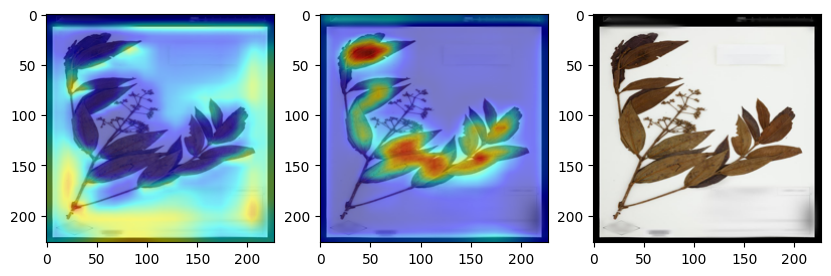

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00002.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.4787648916244507
Leandra nianga (DC.) Cogn. 0.2269047498703003
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00003.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.7156347632408142
Clidemia bullosa DC. 0.16713587939739227
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00004.jpg Detecting for class Miconia corymbiformis Cogn. by model resnet50
-
Miconia corymbiformis Cogn. 0.7792205810546875
Miconia ibaguensis (Bonpl.) Triana 0.12550857663154602
--------------------------------


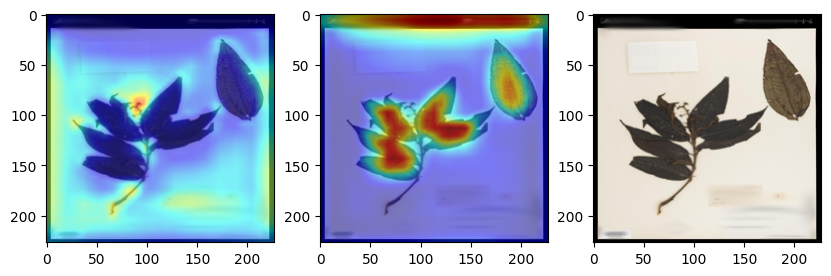

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00005.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.5250090956687927
Macairea parvifolia Benth. 0.36907559633255005
--------------------------------


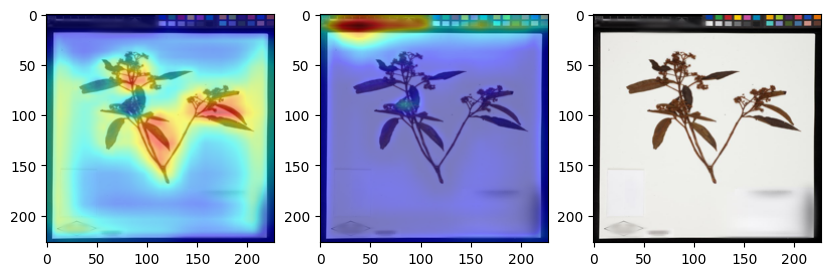

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00006.jpg Detecting for class Macairea parvifolia Benth. by model resnet50
-
Macairea parvifolia Benth. 0.505416989326477
Miconia racemosa (Aubl.) DC. 0.25899049639701843
--------------------------------


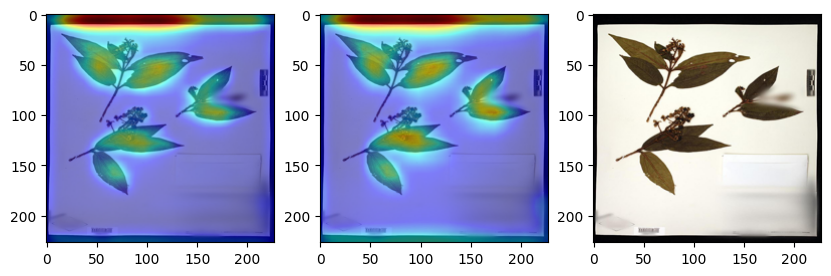

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00007.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.4662412106990814
Macairea parvifolia Benth. 0.3940533995628357
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00008.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.8145155906677246
Leandra nianga (DC.) Cogn. 0.06856119632720947
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00009.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.3898473083972931
Leandra nianga (DC.) Cogn. 0.17034782469272614
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00010.jpg Detecting for class Macairea parvifolia Benth. by model resnet50
-
Macairea parvifolia Benth. 0.51

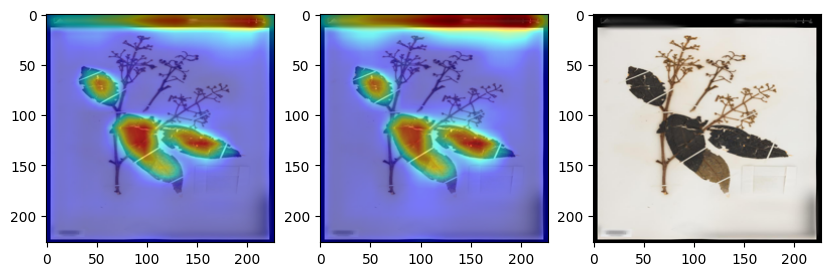

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00011.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.4542948603630066
Clidemia bullosa DC. 0.21590891480445862
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00012.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.7908321619033813
Miconia ibaguensis (Bonpl.) Triana 0.1065632700920105
--------------------------------


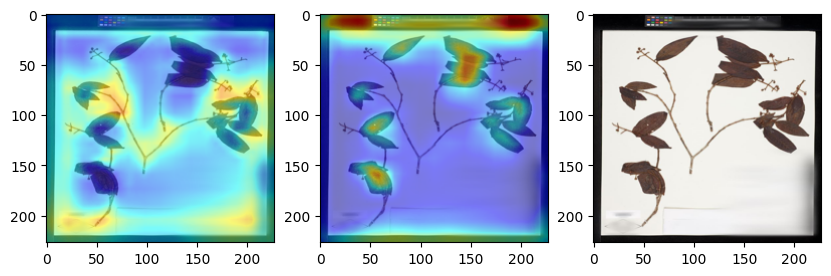

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00013.jpg Detecting for class Tibouchina ciliaris (Vent.) Cogn. by model resnet50
-
Tibouchina ciliaris (Vent.) Cogn. 0.4052801728248596
Miconia ibaguensis (Bonpl.) Triana 0.24238425493240356
--------------------------------


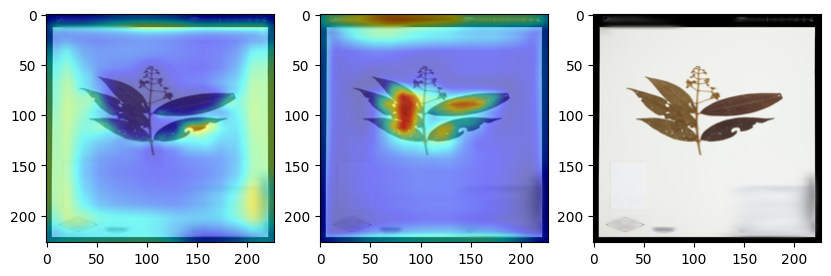

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00014.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.3124101161956787
Miconia racemosa (Aubl.) DC. 0.253086119890213
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00016.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.39831599593162537
Mouriri myrtilloides (Sw.) Poir. 0.21265897154808044
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00015.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.663784384727478
Clidemia bullosa DC. 0.14117245376110077
--------------------------------
real class name:  Leandra nianga (DC.) Cogn.
image 00000.jpg Detecting for class Blakea henripittieri (Cogn.) Penneys & Almeda by model resnet50
-
Blakea henripittier

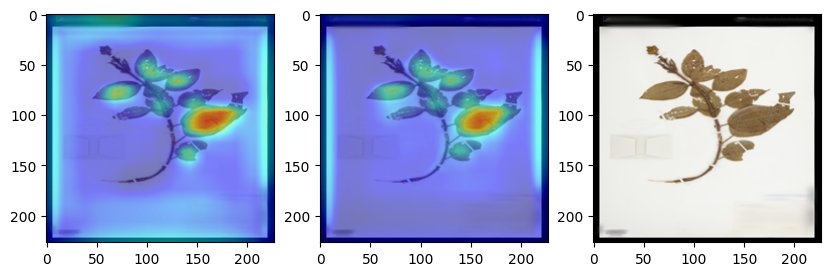

real class name:  Leandra nianga (DC.) Cogn.
image 00001.jpg Detecting for class Leandra nianga (DC.) Cogn. by model resnet50
-
Leandra nianga (DC.) Cogn. 0.40874427556991577
Miconia ibaguensis (Bonpl.) Triana 0.2759764790534973
--------------------------------
real class name:  Tibouchina semidecandra Cogn.
image 00000.jpg Detecting for class Tibouchina semidecandra Cogn. by model resnet50
-
Tibouchina semidecandra Cogn. 0.36407536268234253
Tibouchina ciliaris (Vent.) Cogn. 0.28187301754951477
--------------------------------
real class name:  Tibouchina semidecandra Cogn.
image 00001.jpg Detecting for class Tibouchina ciliaris (Vent.) Cogn. by model resnet50
-
Tibouchina ciliaris (Vent.) Cogn. 0.6710986495018005
Tibouchina semidecandra Cogn. 0.2749008536338806
--------------------------------


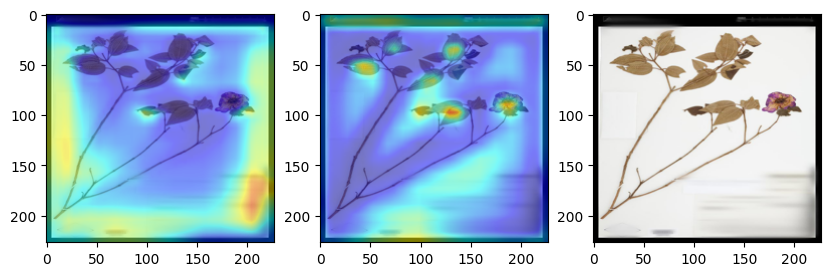

real class name:  Miconia racemosa (Aubl.) DC.
image 00000.jpg Detecting for class Miconia impetiolaris (Sw.) D.Don ex DC. by model resnet50
-
Miconia impetiolaris (Sw.) D.Don ex DC. 0.7844445109367371
Miconia racemosa (Aubl.) DC. 0.15223300457000732
--------------------------------


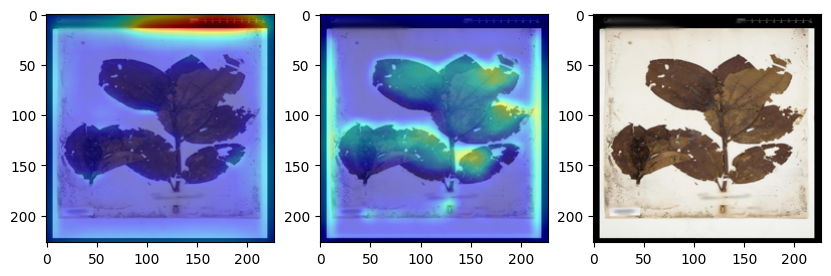

real class name:  Miconia racemosa (Aubl.) DC.
image 00001.jpg Detecting for class Miconia impetiolaris (Sw.) D.Don ex DC. by model resnet50
-
Miconia impetiolaris (Sw.) D.Don ex DC. 0.7186928987503052
Miconia racemosa (Aubl.) DC. 0.18835106492042542
--------------------------------


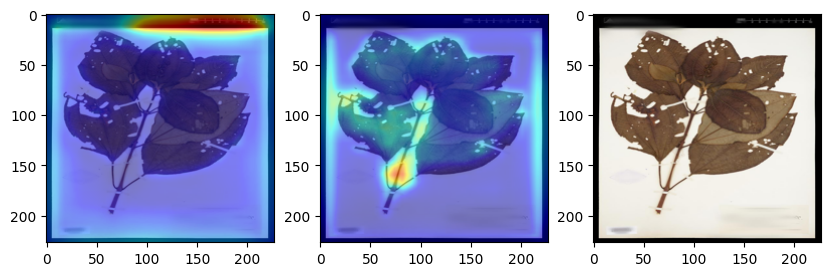

real class name:  Miconia racemosa (Aubl.) DC.
image 00002.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.742046594619751
Mouriri myrtilloides (Sw.) Poir. 0.10650406032800674
--------------------------------
real class name:  Miconia racemosa (Aubl.) DC.
image 00003.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.5455723404884338
Miconia ibaguensis (Bonpl.) Triana 0.2584768235683441
--------------------------------


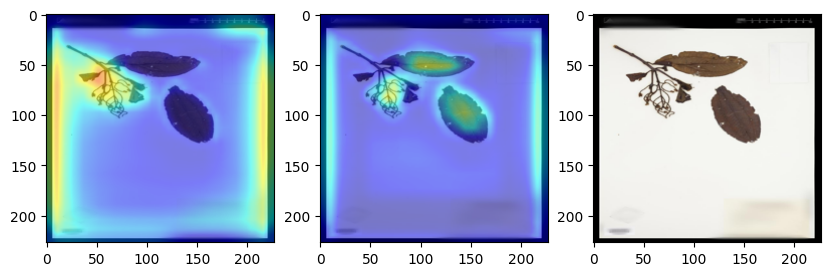

real class name:  Miconia racemosa (Aubl.) DC.
image 00004.jpg Detecting for class Miconia impetiolaris (Sw.) D.Don ex DC. by model resnet50
-
Miconia impetiolaris (Sw.) D.Don ex DC. 0.533952534198761
Miconia racemosa (Aubl.) DC. 0.3024064600467682
--------------------------------


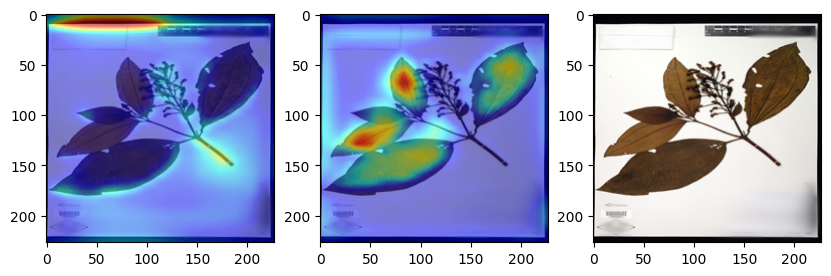

real class name:  Miconia racemosa (Aubl.) DC.
image 00005.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9152373671531677
Miconia impetiolaris (Sw.) D.Don ex DC. 0.06517776846885681
--------------------------------
real class name:  Miconia racemosa (Aubl.) DC.
image 00006.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.6001692414283752
Miconia racemosa (Aubl.) DC. 0.23320220410823822
--------------------------------


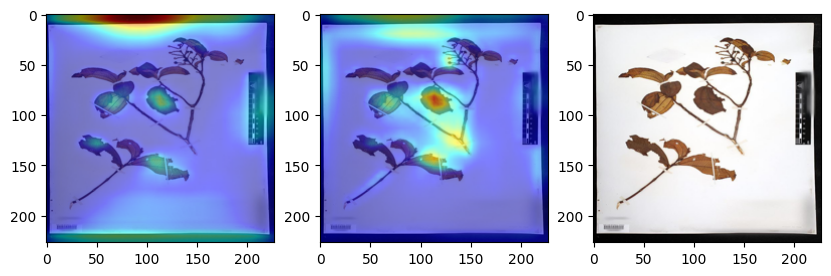

real class name:  Miconia racemosa (Aubl.) DC.
image 00007.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.8291262984275818
Miconia impetiolaris (Sw.) D.Don ex DC. 0.11626189202070236
--------------------------------
real class name:  Miconia racemosa (Aubl.) DC.
image 00008.jpg Detecting for class Blakea henripittieri (Cogn.) Penneys & Almeda by model resnet50
-
Blakea henripittieri (Cogn.) Penneys & Almeda 0.3577020764350891
Clidemia bullosa DC. 0.21910038590431213
--------------------------------


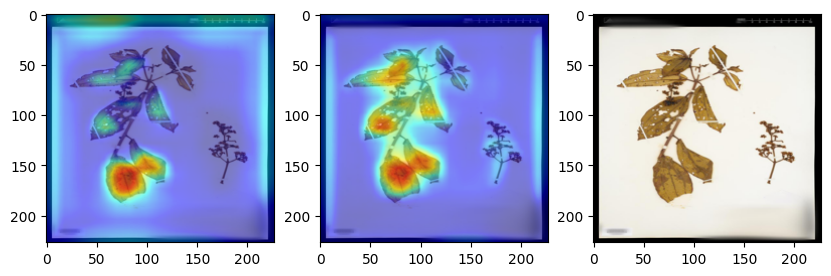

real class name:  Miconia racemosa (Aubl.) DC.
image 00009.jpg Detecting for class Miconia impetiolaris (Sw.) D.Don ex DC. by model resnet50
-
Miconia impetiolaris (Sw.) D.Don ex DC. 0.9799791574478149
Miconia racemosa (Aubl.) DC. 0.014428587630391121
--------------------------------


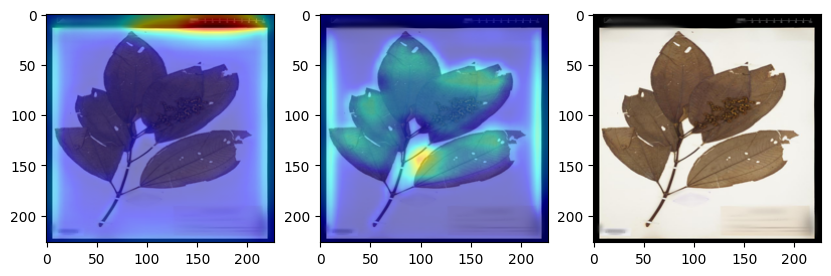

real class name:  Miconia racemosa (Aubl.) DC.
image 00010.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.7861047387123108
Miconia ibaguensis (Bonpl.) Triana 0.09879808872938156
--------------------------------
real class name:  Comolia lythrarioides Naudin
image 00000.jpg Detecting for class Comolia lythrarioides Naudin by model resnet50
-
Comolia lythrarioides Naudin 0.8136312961578369
Tibouchina ciliaris (Vent.) Cogn. 0.142104372382164
--------------------------------
real class name:  Comolia lythrarioides Naudin
image 00001.jpg Detecting for class Comolia lythrarioides Naudin by model resnet50
-
Comolia lythrarioides Naudin 0.745468258857727
Tibouchina ciliaris (Vent.) Cogn. 0.2266734093427658
--------------------------------
real class name:  Comolia lythrarioides Naudin
image 00002.jpg Detecting for class Tibouchina ciliaris (Vent.) Cogn. by model resnet50
-
Tibouchina ciliaris (Vent.) Cogn. 0.5982937812805176
Comolia lyth

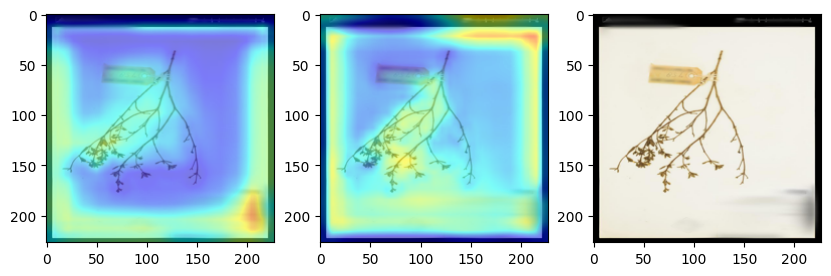

real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00000.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.9846698045730591
Macairea parvifolia Benth. 0.011800440028309822
--------------------------------
real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00001.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.8889289498329163
Miconia ibaguensis (Bonpl.) Triana 0.04101064056158066
--------------------------------
real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00002.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.4200139343738556
Tibouchina ciliaris (Vent.) Cogn. 0.3300420045852661
--------------------------------
real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00003.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Po

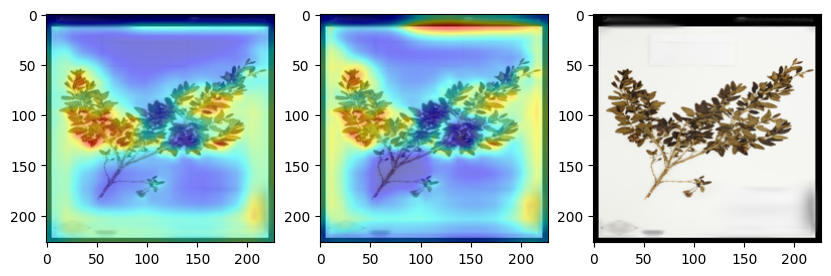

real class name:  Brachyotum strigosum (L.f.) Triana
image 00001.jpg Detecting for class Tibouchina ciliaris (Vent.) Cogn. by model resnet50
-
Tibouchina ciliaris (Vent.) Cogn. 0.9928075075149536
Macairea parvifolia Benth. 0.002756356028839946
--------------------------------


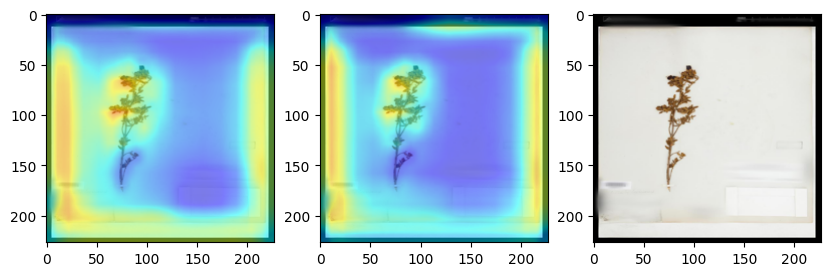

real class name:  Clidemia bullosa DC.
image 00000.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.5727186799049377
Miconia ibaguensis (Bonpl.) Triana 0.17849883437156677
--------------------------------
real class name:  Clidemia bullosa DC.
image 00001.jpg Detecting for class Clidemia bullosa DC. by model resnet50
-
Clidemia bullosa DC. 0.4282490313053131
Blakea henripittieri (Cogn.) Penneys & Almeda 0.21920202672481537
--------------------------------
real class name:  Clidemia bullosa DC.
image 00002.jpg Detecting for class Blakea henripittieri (Cogn.) Penneys & Almeda by model resnet50
-
Blakea henripittieri (Cogn.) Penneys & Almeda 0.2790112793445587
Clidemia bullosa DC. 0.2577281892299652
--------------------------------


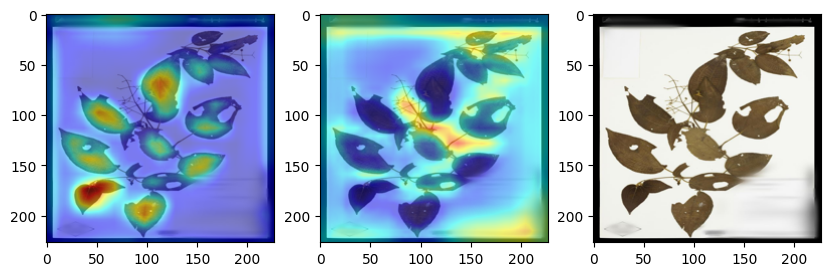

real class name:  Clidemia bullosa DC.
image 00003.jpg Detecting for class Blakea henripittieri (Cogn.) Penneys & Almeda by model resnet50
-
Blakea henripittieri (Cogn.) Penneys & Almeda 0.2300933301448822
Leandra nianga (DC.) Cogn. 0.15021449327468872
--------------------------------


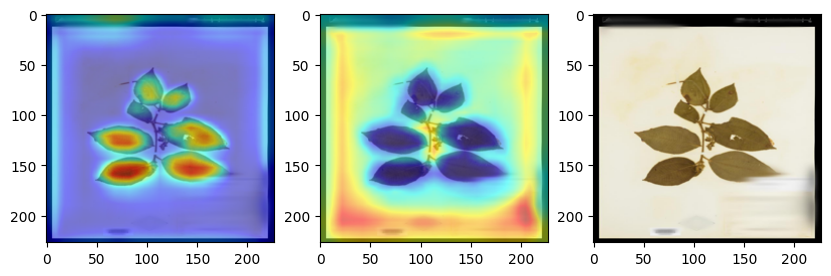

real class name:  Clidemia bullosa DC.
image 00004.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.3283270001411438
Miconia corymbiformis Cogn. 0.21555756032466888
--------------------------------


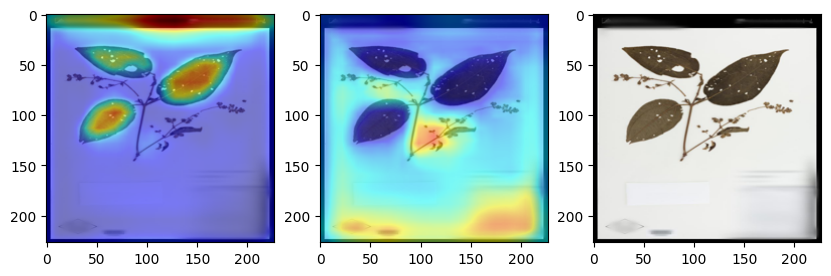

real class name:  Clidemia bullosa DC.
image 00005.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.7553962469100952
Mouriri myrtilloides (Sw.) Poir. 0.22548642754554749
--------------------------------


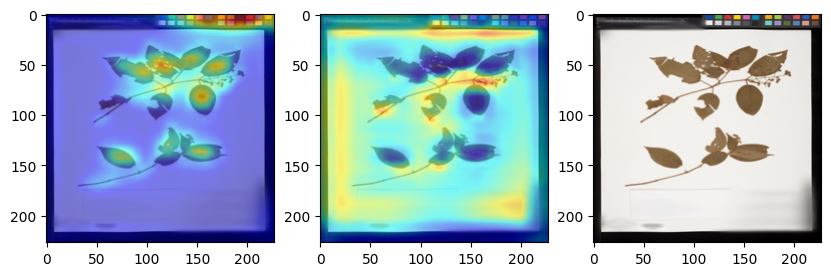

real class name:  Mouriri sagotiana Triana
image 00000.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.3759576678276062
Leandra nianga (DC.) Cogn. 0.19782161712646484
--------------------------------


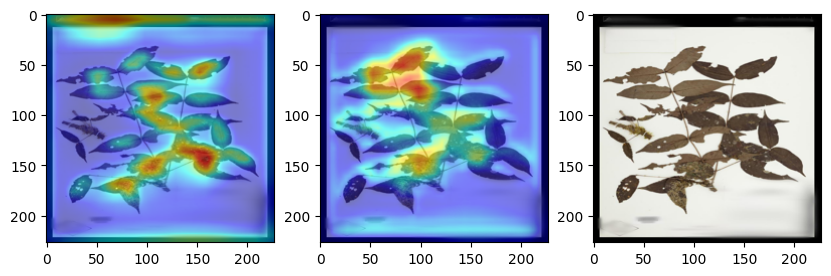

real class name:  Mouriri sagotiana Triana
image 00001.jpg Detecting for class Tibouchina ciliaris (Vent.) Cogn. by model resnet50
-
Tibouchina ciliaris (Vent.) Cogn. 0.8504641056060791
Tibouchina semidecandra Cogn. 0.05904806777834892
--------------------------------


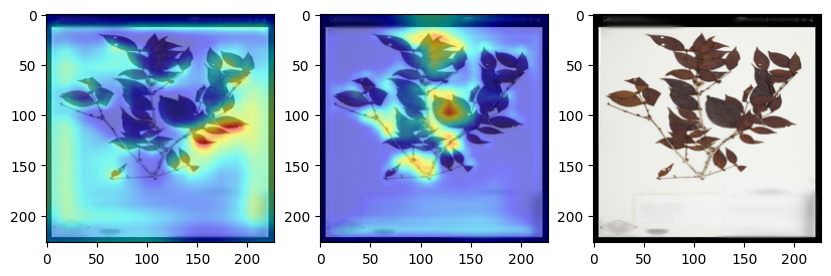

real class name:  Blakea henripittieri (Cogn.) Penneys & Almeda
image 00000.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.42337536811828613
Leandra nianga (DC.) Cogn. 0.1693979650735855
--------------------------------


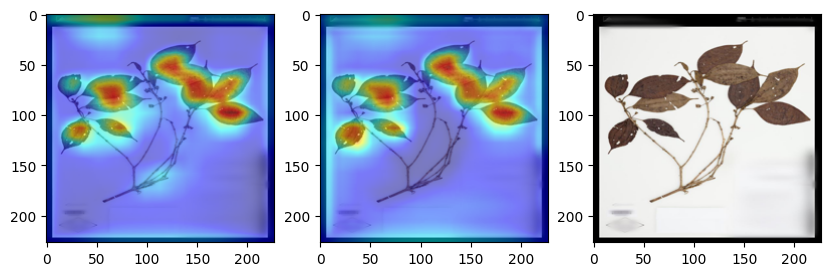

real class name:  Blakea henripittieri (Cogn.) Penneys & Almeda
image 00001.jpg Detecting for class Blakea henripittieri (Cogn.) Penneys & Almeda by model resnet50
-
Blakea henripittieri (Cogn.) Penneys & Almeda 0.8723002672195435
Clidemia bullosa DC. 0.07090076804161072
--------------------------------
real class name:  Blakea henripittieri (Cogn.) Penneys & Almeda
image 00002.jpg Detecting for class Blakea henripittieri (Cogn.) Penneys & Almeda by model resnet50
-
Blakea henripittieri (Cogn.) Penneys & Almeda 0.22052372992038727
Miconia ibaguensis (Bonpl.) Triana 0.17990273237228394
--------------------------------
real class name:  Blakea henripittieri (Cogn.) Penneys & Almeda
image 00003.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9926262497901917
Miconia ibaguensis (Bonpl.) Triana 0.0054178545251488686
--------------------------------


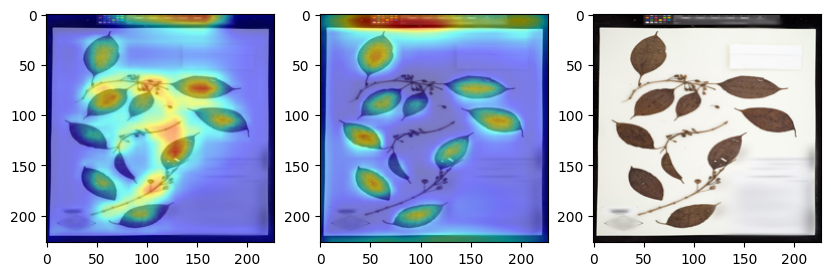

real class name:  Clidemia debilis Crueg.
image 00000.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.3952583372592926
Clidemia bullosa DC. 0.16935454308986664
--------------------------------


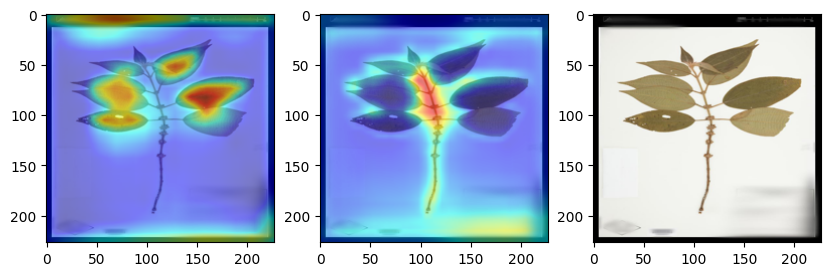

real class name:  Clidemia debilis Crueg.
image 00001.jpg Detecting for class Leandra nianga (DC.) Cogn. by model resnet50
-
Leandra nianga (DC.) Cogn. 0.24338367581367493
Clidemia bullosa DC. 0.24025195837020874
--------------------------------


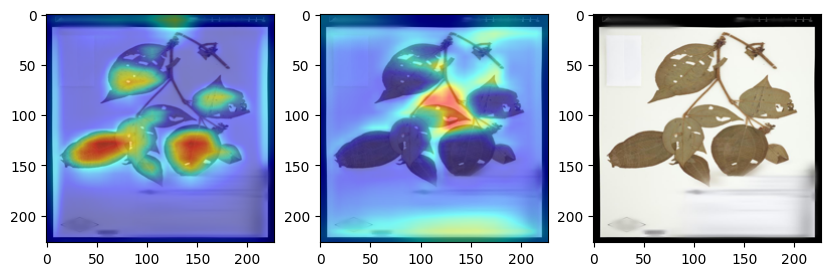

real class name:  Comolia veronicaefolia Benth.
image 00000.jpg Detecting for class Comolia lythrarioides Naudin by model resnet50
-
Comolia lythrarioides Naudin 0.5405673384666443
Tibouchina ciliaris (Vent.) Cogn. 0.44406357407569885
--------------------------------


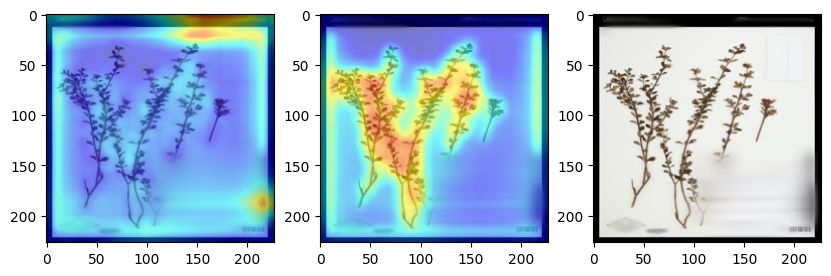

real class name:  Comolia veronicaefolia Benth.
image 00001.jpg Detecting for class Comolia lythrarioides Naudin by model resnet50
-
Comolia lythrarioides Naudin 0.9493491649627686
Tibouchina ciliaris (Vent.) Cogn. 0.041505467146635056
--------------------------------


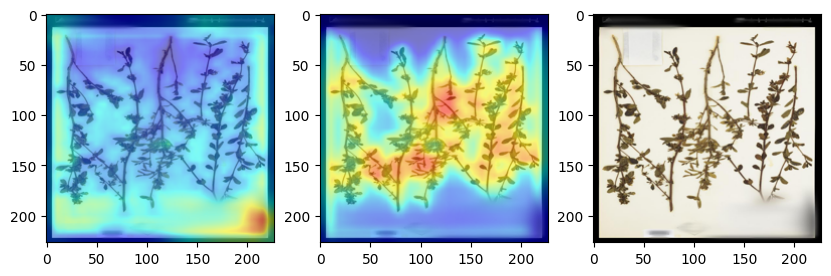

real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00000.jpg Detecting for class Centradenia inaequilateralis (Schltdl. & Cham.) G.Don by model resnet50
-
Centradenia inaequilateralis (Schltdl. & Cham.) G.Don 0.9489398002624512
Tibouchina ciliaris (Vent.) Cogn. 0.04148590937256813
--------------------------------
real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00001.jpg Detecting for class Centradenia inaequilateralis (Schltdl. & Cham.) G.Don by model resnet50
-
Centradenia inaequilateralis (Schltdl. & Cham.) G.Don 0.7378535270690918
Tibouchina ciliaris (Vent.) Cogn. 0.22219571471214294
--------------------------------
real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00002.jpg Detecting for class Tibouchina ciliaris (Vent.) Cogn. by model resnet50
-
Tibouchina ciliaris (Vent.) Cogn. 0.7499117851257324
Comolia lythrarioides Naudin 0.1806982457637787
--------------------------------


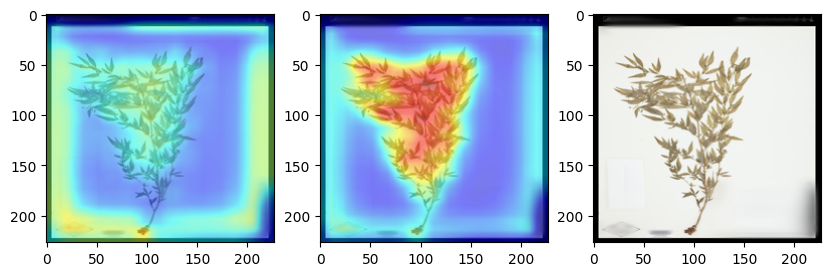

real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00003.jpg Detecting for class Tibouchina ciliaris (Vent.) Cogn. by model resnet50
-
Tibouchina ciliaris (Vent.) Cogn. 0.4538259506225586
Centradenia inaequilateralis (Schltdl. & Cham.) G.Don 0.41558682918548584
--------------------------------


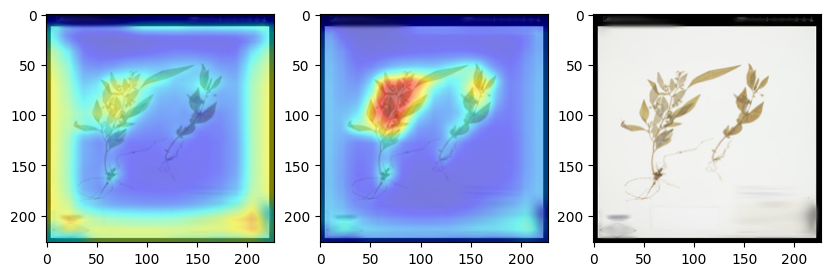

real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00004.jpg Detecting for class Tibouchina ciliaris (Vent.) Cogn. by model resnet50
-
Tibouchina ciliaris (Vent.) Cogn. 0.8242226839065552
Comolia lythrarioides Naudin 0.13655057549476624
--------------------------------


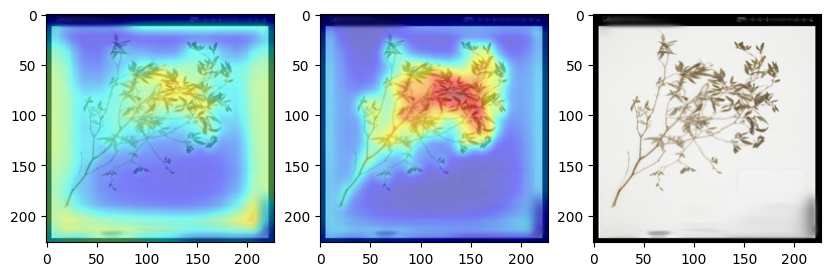

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00000.jpg Detecting for class Miconia impetiolaris (Sw.) D.Don ex DC. by model resnet50
-
Miconia impetiolaris (Sw.) D.Don ex DC. 0.9892644286155701
Miconia racemosa (Aubl.) DC. 0.01064024493098259
--------------------------------
real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00001.jpg Detecting for class Miconia corymbiformis Cogn. by model resnet50
-
Miconia corymbiformis Cogn. 0.7262387871742249
Miconia impetiolaris (Sw.) D.Don ex DC. 0.22763285040855408
--------------------------------


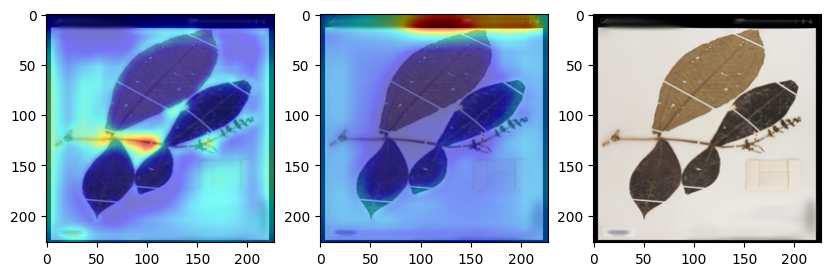

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00002.jpg Detecting for class Miconia impetiolaris (Sw.) D.Don ex DC. by model resnet50
-
Miconia impetiolaris (Sw.) D.Don ex DC. 0.9814994931221008
Miconia corymbiformis Cogn. 0.0075797755271196365
--------------------------------
real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00003.jpg Detecting for class Leandra nianga (DC.) Cogn. by model resnet50
-
Leandra nianga (DC.) Cogn. 0.2178000658750534
Miconia corymbiformis Cogn. 0.17985333502292633
--------------------------------


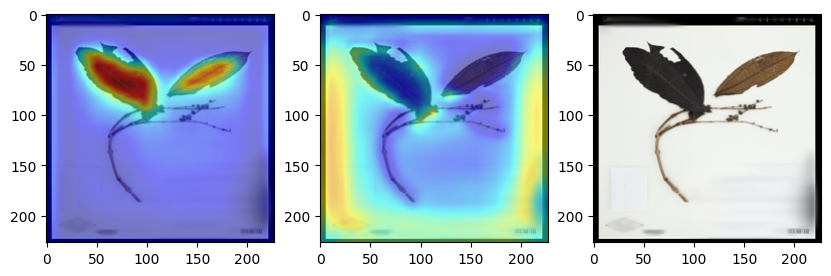

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00004.jpg Detecting for class Miconia impetiolaris (Sw.) D.Don ex DC. by model resnet50
-
Miconia impetiolaris (Sw.) D.Don ex DC. 0.653234601020813
Miconia racemosa (Aubl.) DC. 0.34365835785865784
--------------------------------
real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00005.jpg Detecting for class Miconia impetiolaris (Sw.) D.Don ex DC. by model resnet50
-
Miconia impetiolaris (Sw.) D.Don ex DC. 0.9868143796920776
Miconia ibaguensis (Bonpl.) Triana 0.00699629308655858
--------------------------------
real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00006.jpg Detecting for class Miconia impetiolaris (Sw.) D.Don ex DC. by model resnet50
-
Miconia impetiolaris (Sw.) D.Don ex DC. 0.806126058101654
Miconia corymbiformis Cogn. 0.18266212940216064
--------------------------------
real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00007.jpg Detecting for class Miconia impetiolar

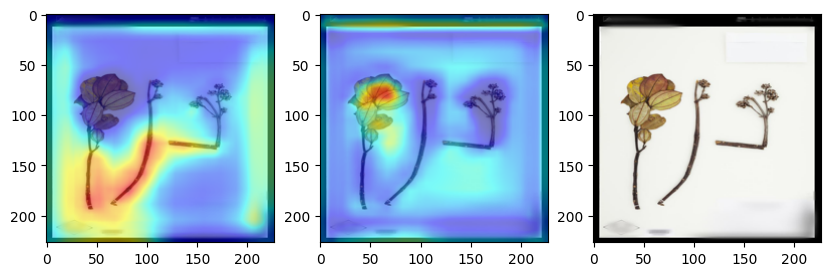

real class name:  Graffenrieda harlingii Wurdack
image 00001.jpg Detecting for class Miconia corymbiformis Cogn. by model resnet50
-
Miconia corymbiformis Cogn. 0.2336835116147995
Miconia impetiolaris (Sw.) D.Don ex DC. 0.19252607226371765
--------------------------------


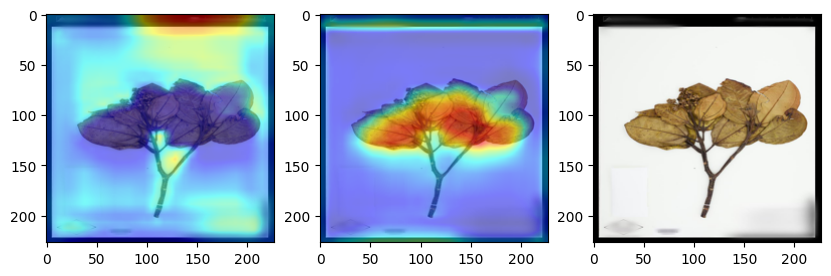

real class name:  Tibouchina ciliaris (Vent.) Cogn.
image 00000.jpg Detecting for class Tibouchina ciliaris (Vent.) Cogn. by model resnet50
-
Tibouchina ciliaris (Vent.) Cogn. 0.8638810515403748
Centradenia inaequilateralis (Schltdl. & Cham.) G.Don 0.09878922253847122
--------------------------------
real class name:  Tibouchina ciliaris (Vent.) Cogn.
image 00001.jpg Detecting for class Leandra nianga (DC.) Cogn. by model resnet50
-
Leandra nianga (DC.) Cogn. 0.24011074006557465
Graffenrieda harlingii Wurdack 0.203464075922966
--------------------------------


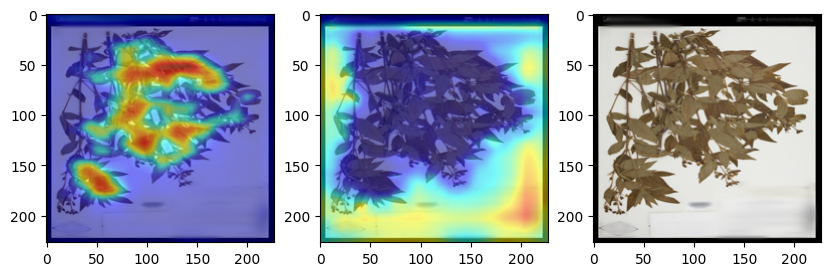

real class name:  Tibouchina ciliaris (Vent.) Cogn.
image 00002.jpg Detecting for class Tibouchina ciliaris (Vent.) Cogn. by model resnet50
-
Tibouchina ciliaris (Vent.) Cogn. 0.989963948726654
Tibouchina semidecandra Cogn. 0.006416612304747105
--------------------------------
real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00000.jpg Detecting for class Miconia corymbiformis Cogn. by model resnet50
-
Miconia corymbiformis Cogn. 0.3644200563430786
Miconia ibaguensis (Bonpl.) Triana 0.346428245306015
--------------------------------


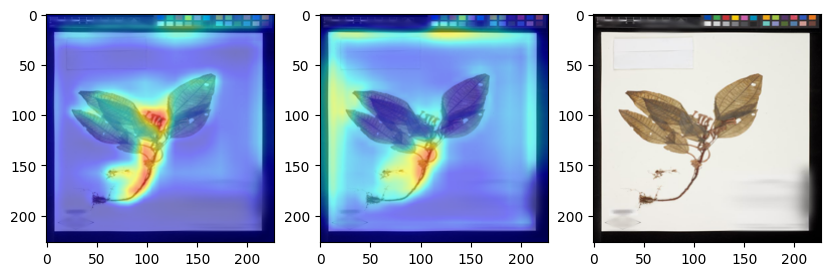

real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00001.jpg Detecting for class Miconia approximata Gamba & Almeda by model resnet50
-
Miconia approximata Gamba & Almeda 0.642907977104187
Miconia corymbiformis Cogn. 0.23613670468330383
--------------------------------


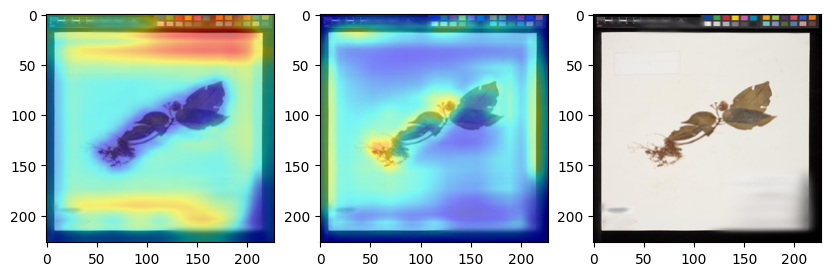

real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00002.jpg Detecting for class Miconia corymbiformis Cogn. by model resnet50
-
Miconia corymbiformis Cogn. 0.5832151174545288
Miconia approximata Gamba & Almeda 0.23050673305988312
--------------------------------


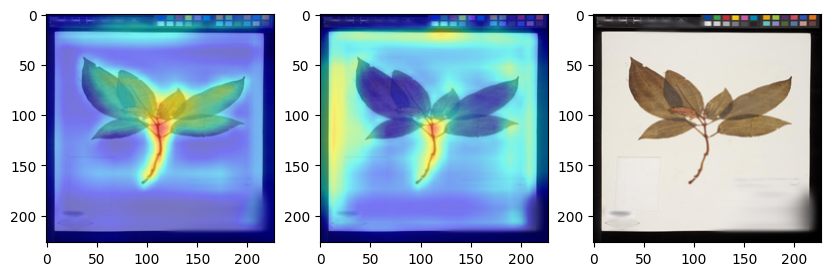

real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00003.jpg Detecting for class Tibouchina ciliaris (Vent.) Cogn. by model resnet50
-
Tibouchina ciliaris (Vent.) Cogn. 0.39276576042175293
Tibouchina semidecandra Cogn. 0.3061620891094208
--------------------------------


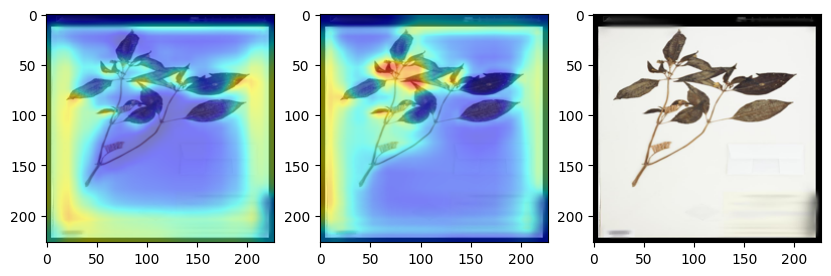

real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00004.jpg Detecting for class Tibouchina ciliaris (Vent.) Cogn. by model resnet50
-
Tibouchina ciliaris (Vent.) Cogn. 0.5952007174491882
Leandra nianga (DC.) Cogn. 0.09938296675682068
--------------------------------


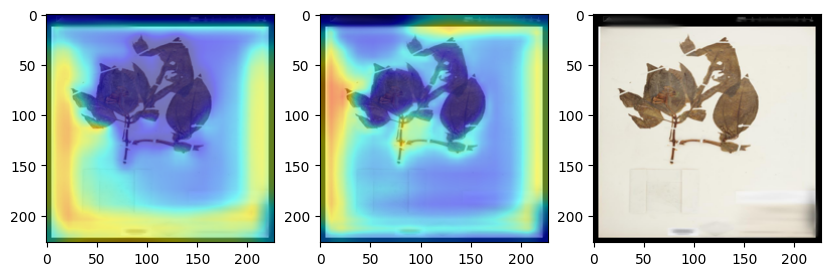

In [36]:
# Load the images
#/content/drive/MyDrive/Model Data/test-images


resize_size =(227,227)
#path = "cnn/saved_models/" +path
resize_to = transforms.Resize((227, 227))
#model.load_state_dict(torch.load(path))
model.eval()
directory = '/content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation'

# use os.listdir() to get a list of all files in the directory
files = os.listdir(directory)
for filename in files:
  #print(filename)
  img_files = os.listdir('/content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation/'+filename)
  for img_file in img_files:
    #print(img_file)
    input_image = Image.open('/content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation/'+filename+"/"+img_file)
    preprocess = transforms.Compose(
          [
              resize_to,
              transforms.ToTensor(),
              transforms.Normalize(
                  mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
              ),  # IMPORTANT: normalize for pretrained models
          ]
    )
    input_tensor = preprocess(input_image)
    input_batch = input_tensor.unsqueeze(0)  # create a mini-batch as expected by the model

    # move the input and model to GPU for speed if available
    if torch.cuda.is_available():
      input_batch = input_batch.to("cuda")
      model.to("cuda")

    with torch.no_grad():
        output = model(input_batch)

    # The output has unnormalized scores. To get probabilities, you can run a softmax on it.
    probabilities = torch.nn.functional.softmax(output[0], dim=0)
    # print(probabilities)
    x , y = torch.topk(probabilities, 1) 
    #print(categories[y])
    print("real class name: ", foldername_to_class[str(filename)])
    print(f"image {img_file} Detecting for class {categories[y]} by model {modelname}")
    #print(f"Detecting for class {img_file + foldername_to_class[str(filename)} +  model {modelname}")
    print("-")
    # Show top categories per image

    top5_prob, top5_catid = torch.topk(probabilities, 2)
    #top1_prob, top1_catid = torch.topk(probabilities, )
    #print(categories[top1_catid[i]])
    for i in range(top5_prob.size(0)):
        print(categories[top5_catid[i]], top5_prob[i].item())

    print("--------------------------------")

    #print("this")
    if categories[y] != foldername_to_class[filename]:
      
      targets0 = [ClassifierOutputTarget(int(key_list[val_list.index(categories[y])]))] #0 for finch ?
      targets1 = [ClassifierOutputTarget(int(key_list[val_list.index(foldername_to_class[filename])]))]

      # You can also pass aug_smooth=True and eigen_smooth=True, to apply smoothing.
      grayscale_cam0 = cam(input_batch, targets=targets0,aug_smooth=True)
      grayscale_cam1 = cam(input_batch, targets=targets1,aug_smooth=True)
      #print( "len grayscale_cam",len(grayscale_cam),grayscale_cam.shape)

      # In this example grayscale_cam has only one image in the batch:
      grayscale_cam0 = grayscale_cam0[0, :]
      grayscale_cam1 = grayscale_cam1[0, :]


      img=np.array(input_image.resize(resize_size),np.float32)
      img = img.reshape(img.shape[1],img.shape[0],img.shape[2])
      #print("img shape",img.shape,img.max())
      img = img/255
      visualization0 = show_cam_on_image(img, grayscale_cam0, use_rgb=True)
      visualization1 = show_cam_on_image(img, grayscale_cam1, use_rgb=True)
      #cam_images = [show_cam_on_image(img, grayscale, use_rgb=True) for img, grayscale in zip(input_image, grayscale_cam)]
      visualization0 = Image.fromarray(visualization0)
      visualization1 = Image.fromarray(visualization1)
      
      
      # fig, ax = plt.subplots(1, 3)
      # ax[0].imshow(visualization0, cmap='gray')
      # ax[1].imshow(visualization1, cmap='gray')
      # ax[2].imshow(input_image.resize(resize_size), cmap='gray')

      


      fig, ax = plt.subplots(1, 3, figsize=(10, 4))

     # Set the aspect ratio of the images to 'equal'
      for i in range(3):
         ax[i].set_aspect('equal')

        # Plot the images on the subplots
      ax[0].imshow(visualization0, cmap='gray')
      ax[1].imshow(visualization1, cmap='gray')
      ax[2].imshow(input_image.resize(resize_size), cmap='gray')
    

      # Show the plot
      plt.show()
   



Input Tensor Shape: torch.Size([3, 227, 227])


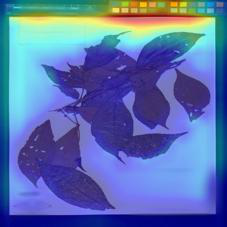

Input Tensor Shape: torch.Size([3, 227, 227])


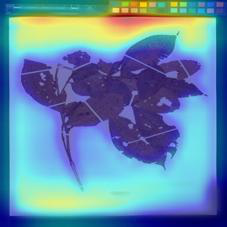

Input Tensor Shape: torch.Size([3, 227, 227])


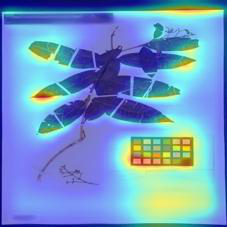

Input Tensor Shape: torch.Size([3, 227, 227])


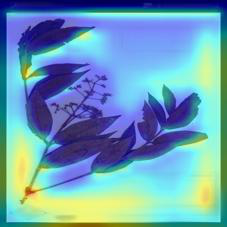

Input Tensor Shape: torch.Size([3, 227, 227])


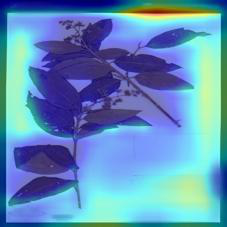

Input Tensor Shape: torch.Size([3, 227, 227])


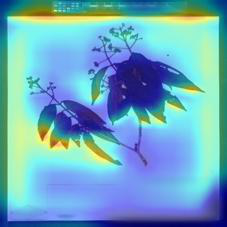

Input Tensor Shape: torch.Size([3, 227, 227])


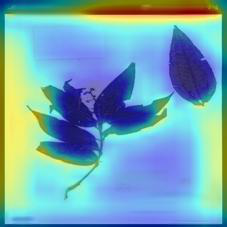

Input Tensor Shape: torch.Size([3, 227, 227])


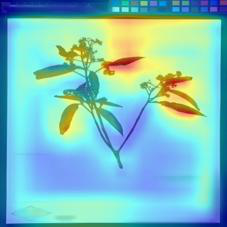

Input Tensor Shape: torch.Size([3, 227, 227])


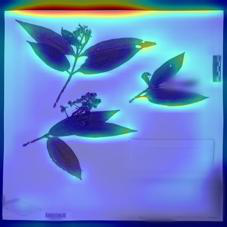

Input Tensor Shape: torch.Size([3, 227, 227])


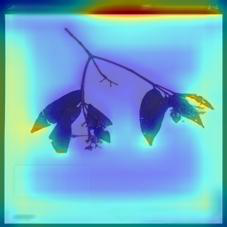

Input Tensor Shape: torch.Size([3, 227, 227])


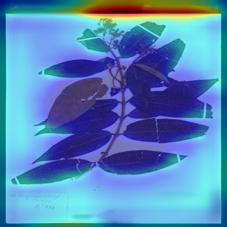

Input Tensor Shape: torch.Size([3, 227, 227])


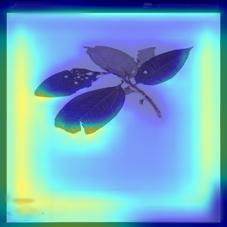

Input Tensor Shape: torch.Size([3, 227, 227])


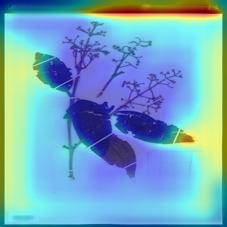

Input Tensor Shape: torch.Size([3, 227, 227])


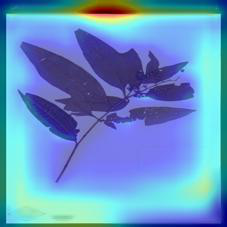

Input Tensor Shape: torch.Size([3, 227, 227])


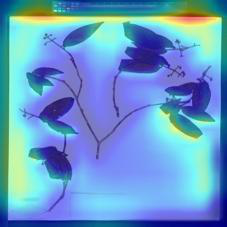

Input Tensor Shape: torch.Size([3, 227, 227])


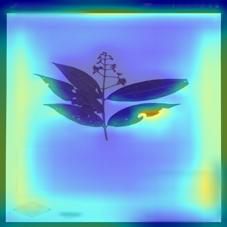

Input Tensor Shape: torch.Size([3, 227, 227])


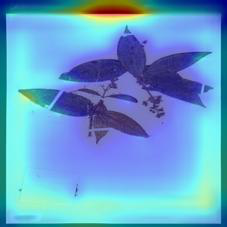

Input Tensor Shape: torch.Size([3, 227, 227])


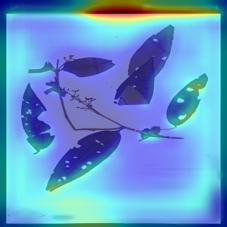

Input Tensor Shape: torch.Size([3, 227, 227])


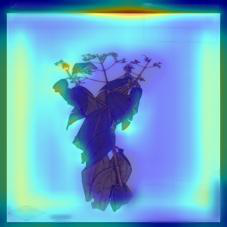

Input Tensor Shape: torch.Size([3, 227, 227])


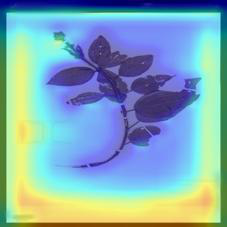

Input Tensor Shape: torch.Size([3, 227, 227])


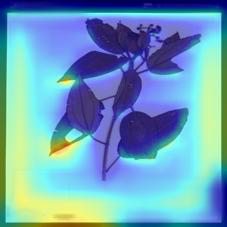

Input Tensor Shape: torch.Size([3, 227, 227])


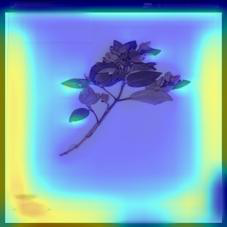

Input Tensor Shape: torch.Size([3, 227, 227])


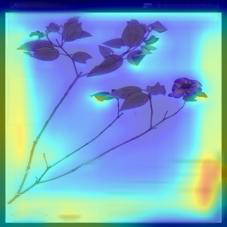

Input Tensor Shape: torch.Size([3, 227, 227])


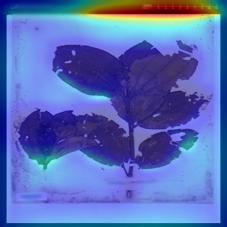

Input Tensor Shape: torch.Size([3, 227, 227])


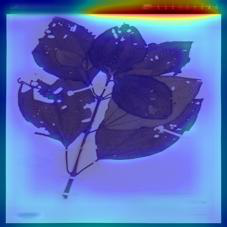

Input Tensor Shape: torch.Size([3, 227, 227])


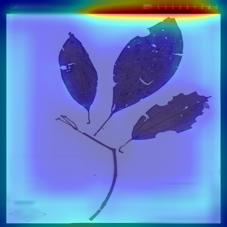

Input Tensor Shape: torch.Size([3, 227, 227])


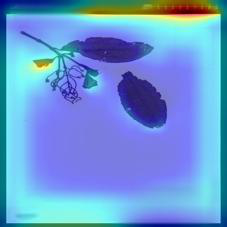

Input Tensor Shape: torch.Size([3, 227, 227])


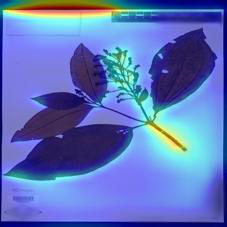

Input Tensor Shape: torch.Size([3, 227, 227])


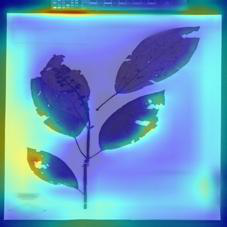

Input Tensor Shape: torch.Size([3, 227, 227])


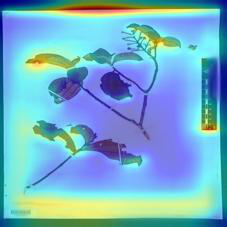

Input Tensor Shape: torch.Size([3, 227, 227])


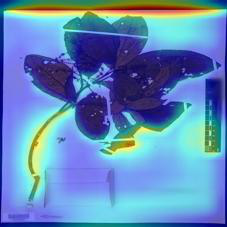

Input Tensor Shape: torch.Size([3, 227, 227])


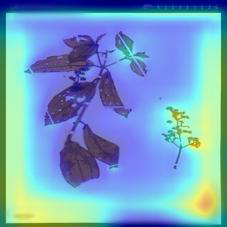

Input Tensor Shape: torch.Size([3, 227, 227])


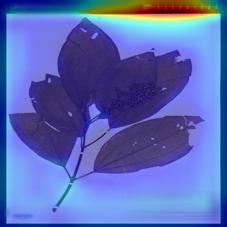

Input Tensor Shape: torch.Size([3, 227, 227])


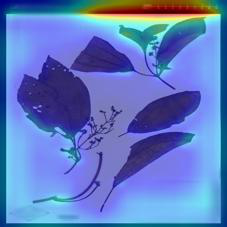

Input Tensor Shape: torch.Size([3, 227, 227])


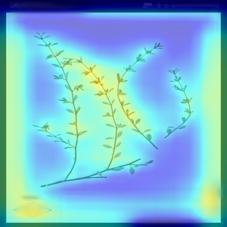

Input Tensor Shape: torch.Size([3, 227, 227])


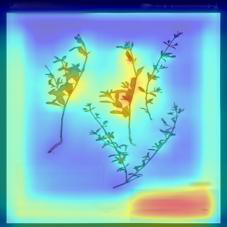

Input Tensor Shape: torch.Size([3, 227, 227])


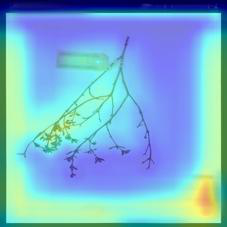

Input Tensor Shape: torch.Size([3, 227, 227])


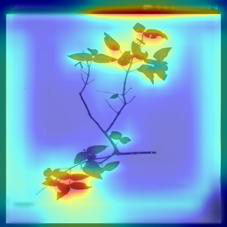

Input Tensor Shape: torch.Size([3, 227, 227])


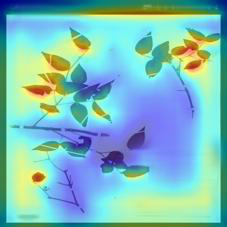

Input Tensor Shape: torch.Size([3, 227, 227])


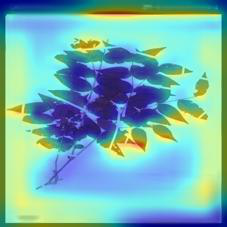

Input Tensor Shape: torch.Size([3, 227, 227])


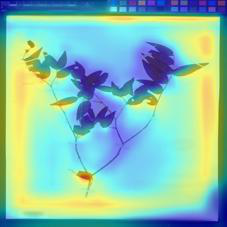

Input Tensor Shape: torch.Size([3, 227, 227])


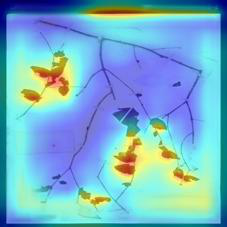

Input Tensor Shape: torch.Size([3, 227, 227])


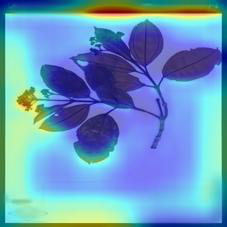

Input Tensor Shape: torch.Size([3, 227, 227])


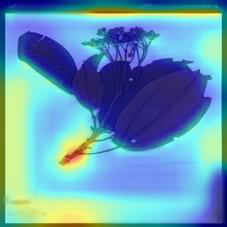

Input Tensor Shape: torch.Size([3, 227, 227])


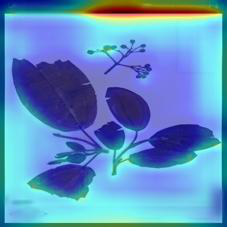

Input Tensor Shape: torch.Size([3, 227, 227])


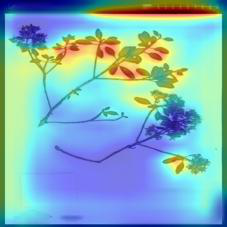

Input Tensor Shape: torch.Size([3, 227, 227])


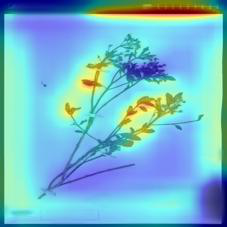

Input Tensor Shape: torch.Size([3, 227, 227])


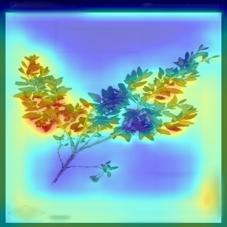

Input Tensor Shape: torch.Size([3, 227, 227])


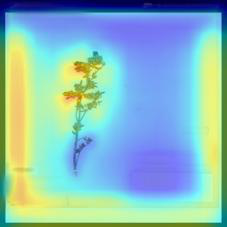

Input Tensor Shape: torch.Size([3, 227, 227])


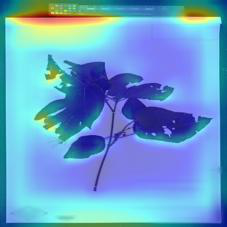

Input Tensor Shape: torch.Size([3, 227, 227])


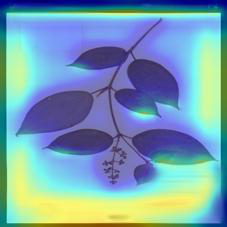

Input Tensor Shape: torch.Size([3, 227, 227])


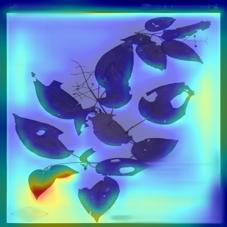

Input Tensor Shape: torch.Size([3, 227, 227])


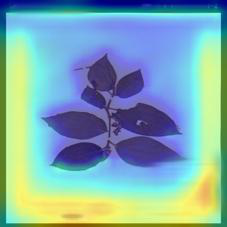

Input Tensor Shape: torch.Size([3, 227, 227])


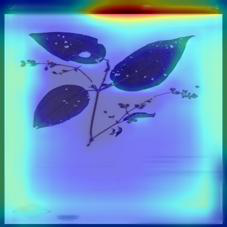

Input Tensor Shape: torch.Size([3, 227, 227])


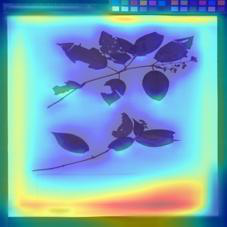

Input Tensor Shape: torch.Size([3, 227, 227])


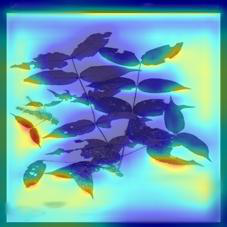

Input Tensor Shape: torch.Size([3, 227, 227])


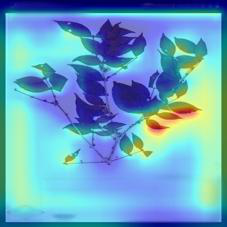

Input Tensor Shape: torch.Size([3, 227, 227])


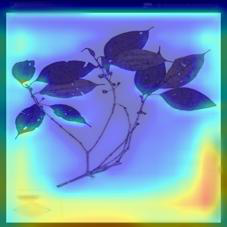

Input Tensor Shape: torch.Size([3, 227, 227])


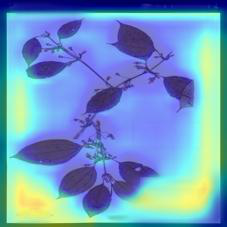

Input Tensor Shape: torch.Size([3, 227, 227])


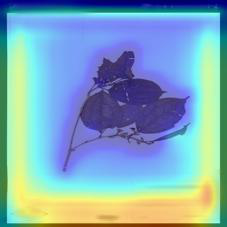

Input Tensor Shape: torch.Size([3, 227, 227])


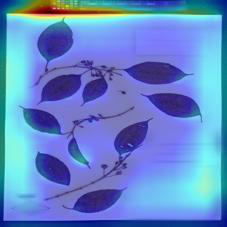

Input Tensor Shape: torch.Size([3, 227, 227])


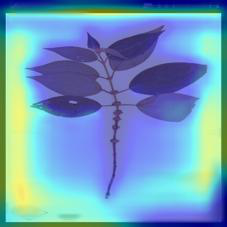

Input Tensor Shape: torch.Size([3, 227, 227])


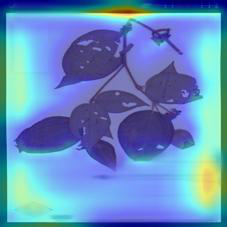

Input Tensor Shape: torch.Size([3, 227, 227])


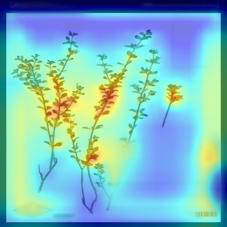

Input Tensor Shape: torch.Size([3, 227, 227])


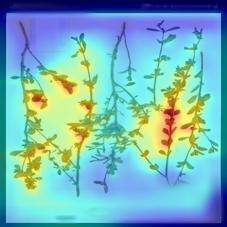

Input Tensor Shape: torch.Size([3, 227, 227])


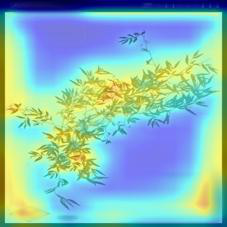

Input Tensor Shape: torch.Size([3, 227, 227])


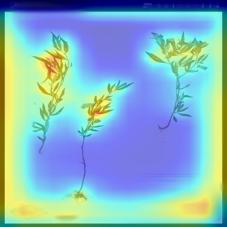

Input Tensor Shape: torch.Size([3, 227, 227])


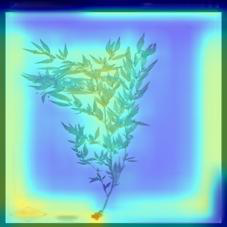

Input Tensor Shape: torch.Size([3, 227, 227])


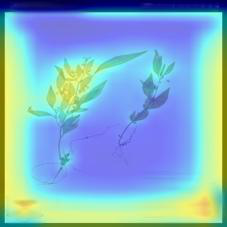

Input Tensor Shape: torch.Size([3, 227, 227])


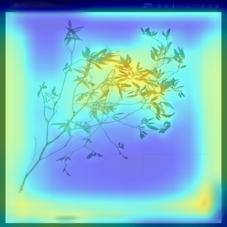

Input Tensor Shape: torch.Size([3, 227, 227])


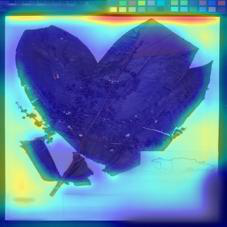

Input Tensor Shape: torch.Size([3, 227, 227])


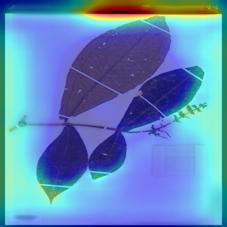

Input Tensor Shape: torch.Size([3, 227, 227])


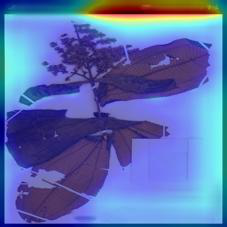

Input Tensor Shape: torch.Size([3, 227, 227])


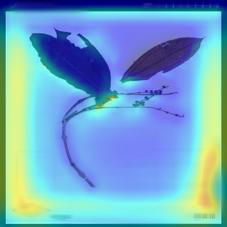

Input Tensor Shape: torch.Size([3, 227, 227])


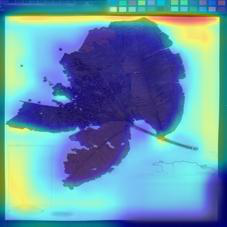

Input Tensor Shape: torch.Size([3, 227, 227])


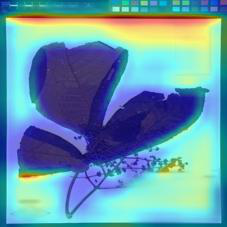

Input Tensor Shape: torch.Size([3, 227, 227])


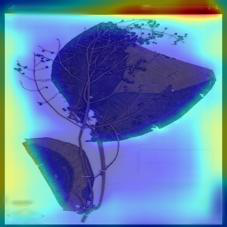

Input Tensor Shape: torch.Size([3, 227, 227])


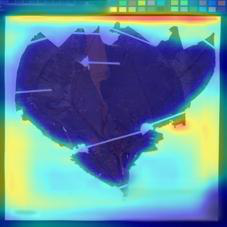

Input Tensor Shape: torch.Size([3, 227, 227])


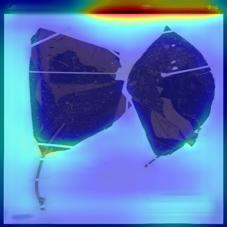

Input Tensor Shape: torch.Size([3, 227, 227])


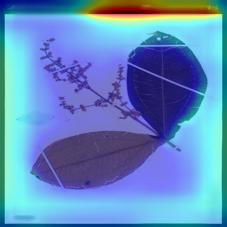

Input Tensor Shape: torch.Size([3, 227, 227])


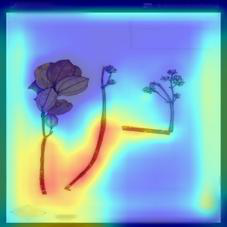

Input Tensor Shape: torch.Size([3, 227, 227])


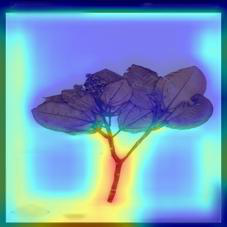

Input Tensor Shape: torch.Size([3, 227, 227])


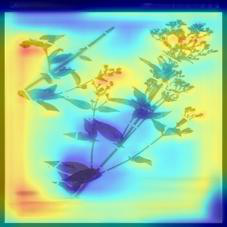

Input Tensor Shape: torch.Size([3, 227, 227])


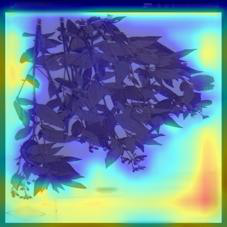

Input Tensor Shape: torch.Size([3, 227, 227])


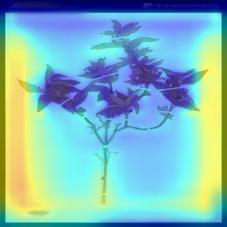

Input Tensor Shape: torch.Size([3, 227, 227])


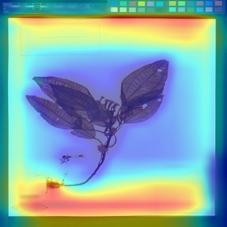

Input Tensor Shape: torch.Size([3, 227, 227])


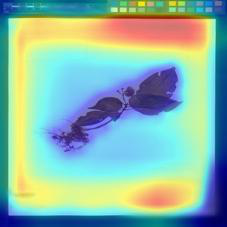

Input Tensor Shape: torch.Size([3, 227, 227])


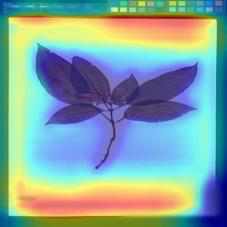

Input Tensor Shape: torch.Size([3, 227, 227])


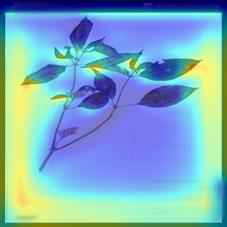

Input Tensor Shape: torch.Size([3, 227, 227])


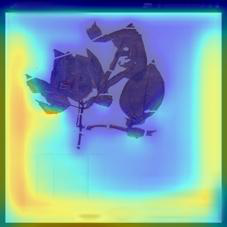

In [37]:
# Load the images
#/content/drive/MyDrive/Model Data/test-images

resize_size =(227,227)

directory = '/content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation'

# use os.listdir() to get a list of all files in the directory
files = os.listdir(directory)
for foldername in files:
  img_files = os.listdir('/content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation/'+foldername)
  for filename in img_files:
      input_image = Image.open('/content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation/'+foldername +'/' +filename)

      preprocess = transforms.Compose(
          [
              resize_to,
              transforms.ToTensor(),
              transforms.Normalize(
                  mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
              ),  # IMPORTANT: normalize for pre-trained models
          ]
      )
      input_tensor = preprocess(input_image)
      print("Input Tensor Shape:", input_tensor.shape)
      input_batch = input_tensor.unsqueeze(0)  # create a mini-batch as expected by the model
      # move the input and model to GPU for speed if available
      if torch.cuda.is_available():
          input_batch = input_batch.to("cuda")
          model.to("cuda")
          input_tensor = input_tensor.to("cuda")

      # We have to specify the target we want to generate
      # the Class Activation Maps for.
      # If targets is None, the highest scoring category
      # will be used for every image in the batch.
      # Here we use ClassifierOutputTarget, but you can define your own custom targets

      # That are, for example, combinations of categories, or specific outputs in a non standard model.
      targets0 = [ClassifierOutputTarget(int(key_list[val_list.index(categories[y])]))] #0 for finch ?
      #targets1 = [ClassifierOutputTarget(1)]

      # You can also pass aug_smooth=True and eigen_smooth=True, to apply smoothing.
      grayscale_cam0 = cam(input_batch, targets=targets0,aug_smooth=True)
      #grayscale_cam1 = cam(input_batch, targets=targets1,aug_smooth=True)
      #print( "len grayscale_cam",len(grayscale_cam),grayscale_cam.shape)

      # In this example grayscale_cam has only one image in the batch:
      grayscale_cam0 = grayscale_cam0[0, :]
      #grayscale_cam1 = grayscale_cam1[0, :]

      # from PIL import Image
      # im = Image.fromarray(grayscale_cam)
      # if im.mode != 'RGB':
      #     im = im.convert('L')
      # im.save("grayscale_cam.jpeg"

  #/content/drive/MyDrive/Model Data/gradcam_out

      img=np.array(input_image.resize(resize_size),np.float32)
      img = img.reshape(img.shape[1],img.shape[0],img.shape[2])
      #print("img shape",img.shape,img.max())
      img = img/255
      visualization0 = show_cam_on_image(img, grayscale_cam0, use_rgb=True)
      #visualization1 = show_cam_on_image(img, grayscale_cam1, use_rgb=True)
      #cam_images = [show_cam_on_image(img, grayscale, use_rgb=True) for img, grayscale in zip(input_image, grayscale_cam)]
      visualization0 = Image.fromarray(visualization0)
      #visualization1 = Image.fromarray(visualization1)
      out_file_name0 ="/content/drive/MyDrive/Hebarium-Data-2019/Grad_plot20/" +modelname+ "_GradCAM for Miconia approximata Gamba & Almeda_"+gradvariantname+ "_" + foldername_to_class[os.path.basename(foldername)] + "_" +os.path.basename(filename)
      #out_file_name1 ="/content/drive/MyDrive/Hebarium-Data-2019/Grad_plot20/" +modelname+ "_Grad for Miconia ibaguensis (Bonpl.) Triana_"+gradvariantname+ "_" + foldername_to_class[os.path.basename(foldername)] + "_" +os.path.basename(filename)
      visualization0.save(out_file_name0)
      #visualization1.save(out_file_name1)
      #print("Visualization saved- now trying to show (GUI mode)")
      im0 = Image.open(out_file_name0)
      #im1 = Image.open(out_file_name1)
      im0.show()
      #im1.show()
    



## Adverarial attack

In [38]:
classifier = PyTorchClassifier(
    model= model,
    loss=nn.CrossEntropyLoss(),
    input_shape=(3, 224, 224),
    nb_classes=10,
    device_type='gpu'
)

real class name:  Miconia approximata Gamba & Almeda
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9937449097633362
Miconia impetiolaris (Sw.) D.Don ex DC. 0.003984260372817516
--------------------------------


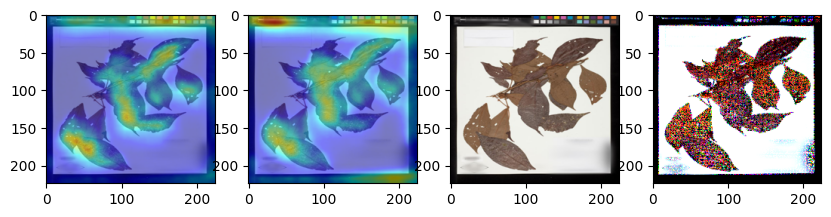

real class name:  Miconia approximata Gamba & Almeda
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9948152899742126
Mouriri myrtilloides (Sw.) Poir. 0.0035003558732569218
--------------------------------


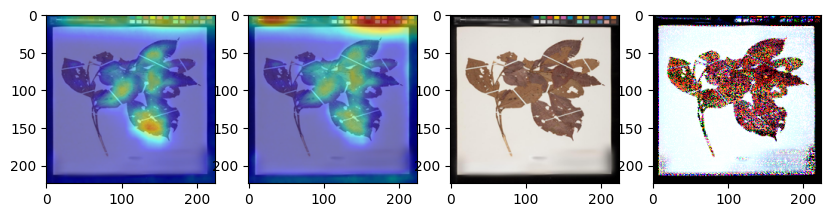

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9730503559112549
Mouriri myrtilloides (Sw.) Poir. 0.024947509169578552
--------------------------------


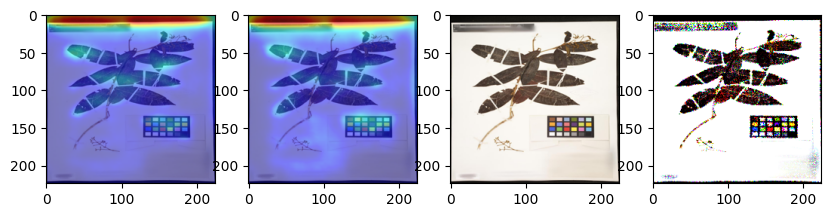

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9849727153778076
Mouriri myrtilloides (Sw.) Poir. 0.015023897401988506
--------------------------------


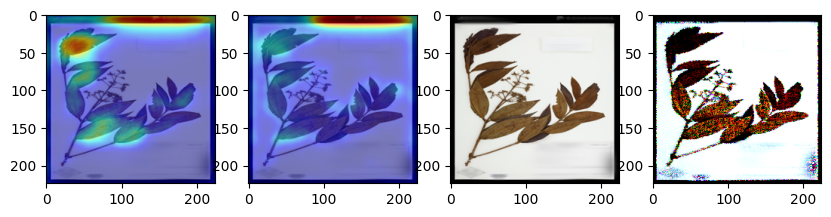

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00002.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9759623408317566
Macairea parvifolia Benth. 0.015879925340414047
--------------------------------


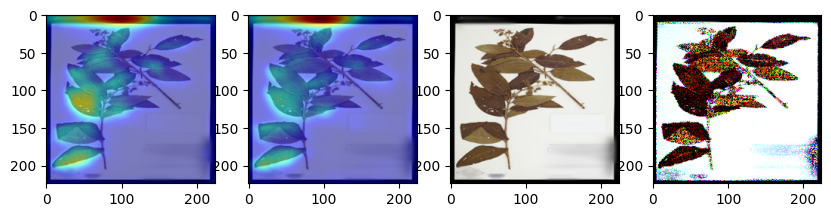

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00003.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.8421124219894409
Mouriri myrtilloides (Sw.) Poir. 0.15788757801055908
--------------------------------


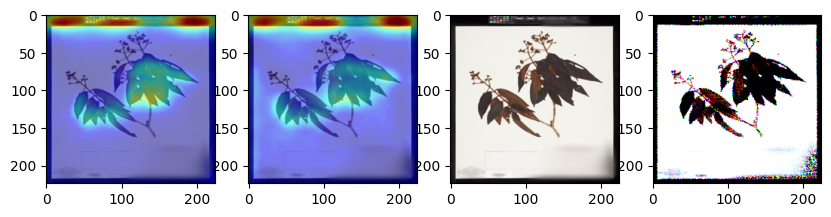

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00004.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.8688308596611023
Miconia impetiolaris (Sw.) D.Don ex DC. 0.061305057257413864
--------------------------------


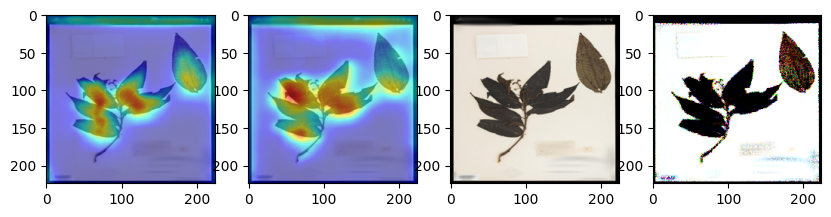

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00005.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.62022864818573
Mouriri myrtilloides (Sw.) Poir. 0.3792169988155365
--------------------------------


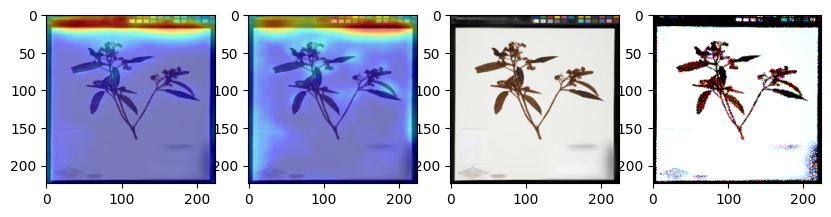

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00006.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.8918055891990662
Miconia impetiolaris (Sw.) D.Don ex DC. 0.10355978459119797
--------------------------------


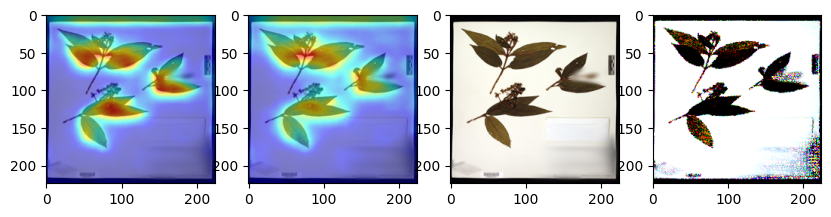

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00007.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9885860085487366
Miconia impetiolaris (Sw.) D.Don ex DC. 0.006899843458086252
--------------------------------


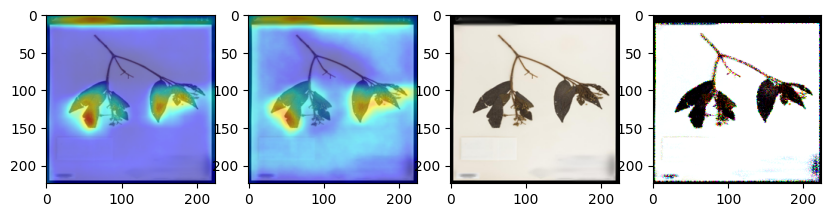

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00008.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.6717906594276428
Miconia corymbiformis Cogn. 0.18164512515068054
--------------------------------
real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00009.jpg Detecting for class Blakea henripittieri (Cogn.) Penneys & Almeda by model resnet50
-
Blakea henripittieri (Cogn.) Penneys & Almeda 0.8665223717689514
Clidemia bullosa DC. 0.07933927327394485
--------------------------------


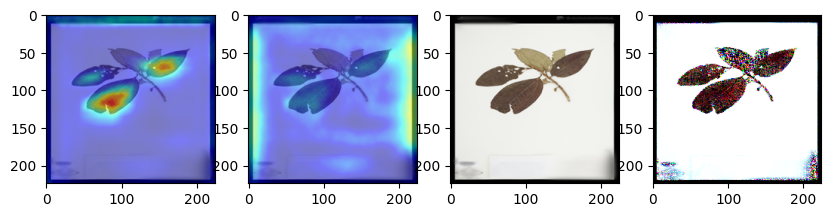

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00010.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9880155920982361
Mouriri myrtilloides (Sw.) Poir. 0.00981768500059843
--------------------------------


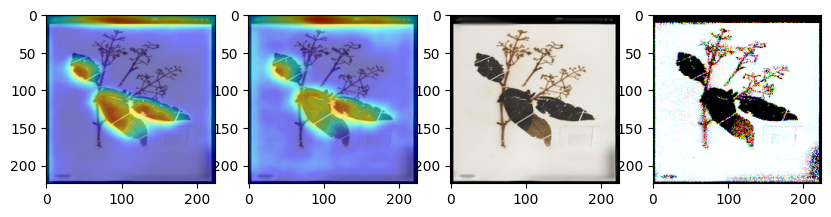

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00011.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9416095018386841
Clidemia bullosa DC. 0.023218294605612755
--------------------------------


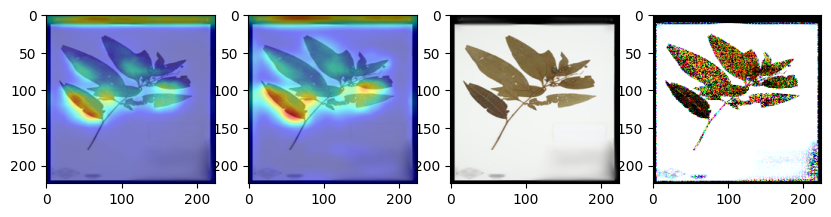

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00012.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.8897924423217773
Mouriri myrtilloides (Sw.) Poir. 0.11020416021347046
--------------------------------


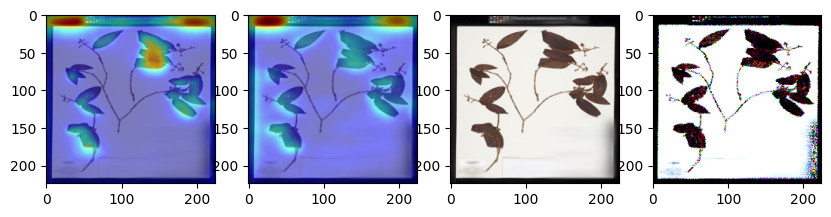

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00013.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.5851916670799255
Macairea parvifolia Benth. 0.3935015797615051
--------------------------------


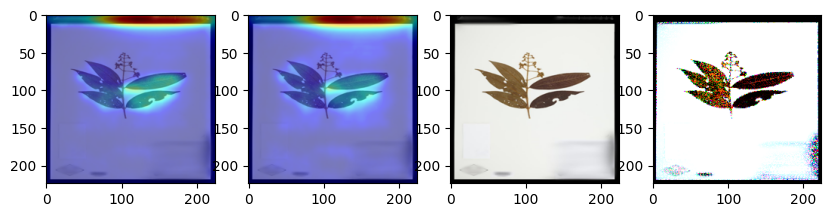

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00014.jpg Detecting for class Macairea parvifolia Benth. by model resnet50
-
Macairea parvifolia Benth. 0.5285227298736572
Miconia racemosa (Aubl.) DC. 0.36828386783599854
--------------------------------


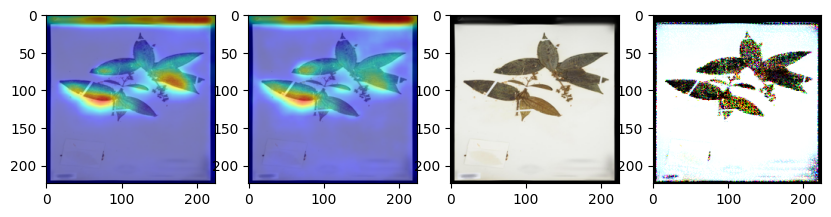

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00016.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9854925274848938
Miconia impetiolaris (Sw.) D.Don ex DC. 0.007639867719262838
--------------------------------


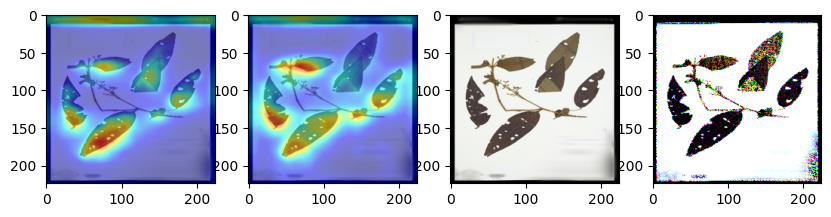

real class name:  Miconia ibaguensis (Bonpl.) Triana
image 00015.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.38622355461120605
Clidemia bullosa DC. 0.34963473677635193
--------------------------------


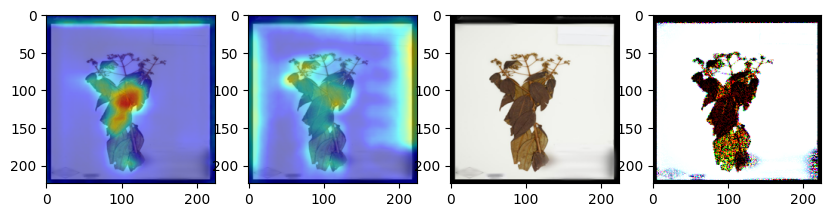

real class name:  Leandra nianga (DC.) Cogn.
image 00000.jpg Detecting for class Blakea henripittieri (Cogn.) Penneys & Almeda by model resnet50
-
Blakea henripittieri (Cogn.) Penneys & Almeda 0.4226174056529999
Miconia racemosa (Aubl.) DC. 0.3276921808719635
--------------------------------


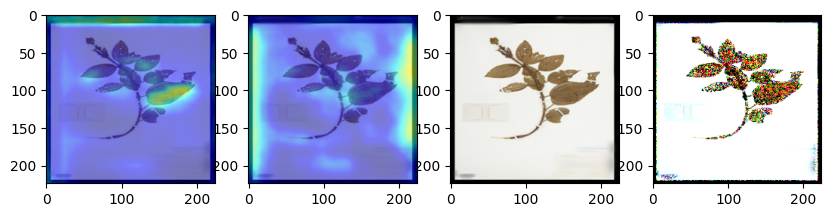

real class name:  Leandra nianga (DC.) Cogn.
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9814514517784119
Macairea parvifolia Benth. 0.015374437905848026
--------------------------------


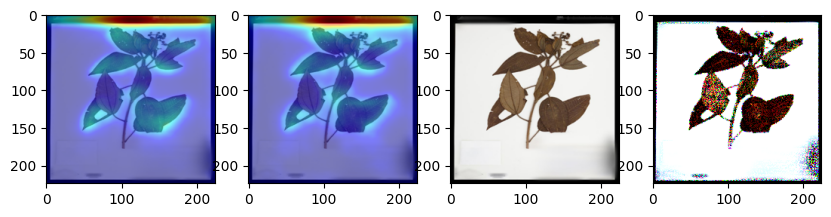

real class name:  Tibouchina semidecandra Cogn.
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.5598080158233643
Miconia ibaguensis (Bonpl.) Triana 0.33022910356521606
--------------------------------


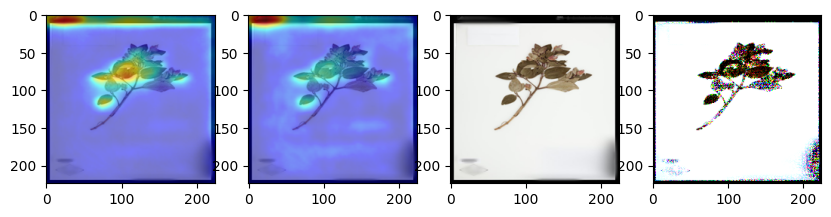

real class name:  Tibouchina semidecandra Cogn.
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.7381748557090759
Miconia ibaguensis (Bonpl.) Triana 0.1401412934064865
--------------------------------


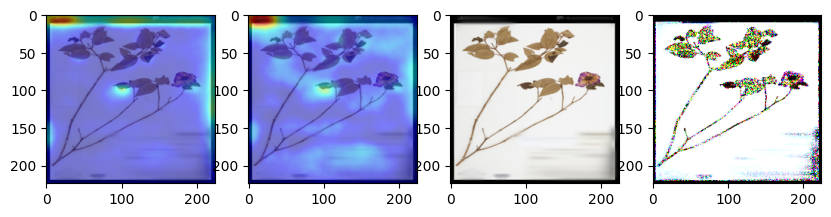

real class name:  Miconia racemosa (Aubl.) DC.
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9297381639480591
Mouriri myrtilloides (Sw.) Poir. 0.06629811972379684
--------------------------------
real class name:  Miconia racemosa (Aubl.) DC.
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9089892506599426
Mouriri myrtilloides (Sw.) Poir. 0.048241328448057175
--------------------------------
real class name:  Miconia racemosa (Aubl.) DC.
image 00002.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.5884537696838379
Clidemia bullosa DC. 0.377543568611145
--------------------------------
real class name:  Miconia racemosa (Aubl.) DC.
image 00003.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9103911519050598
Macairea parvifolia Benth. 0.055131

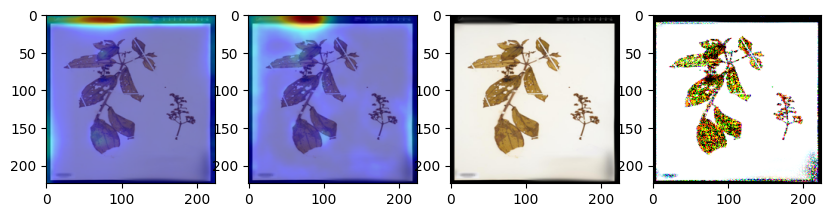

real class name:  Miconia racemosa (Aubl.) DC.
image 00009.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.6039865016937256
Clidemia bullosa DC. 0.22546932101249695
--------------------------------
real class name:  Miconia racemosa (Aubl.) DC.
image 00010.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9972435235977173
Mouriri myrtilloides (Sw.) Poir. 0.0019832223188132048
--------------------------------
real class name:  Comolia lythrarioides Naudin
image 00000.jpg Detecting for class Macairea parvifolia Benth. by model resnet50
-
Macairea parvifolia Benth. 0.9647184610366821
Miconia racemosa (Aubl.) DC. 0.03387654572725296
--------------------------------


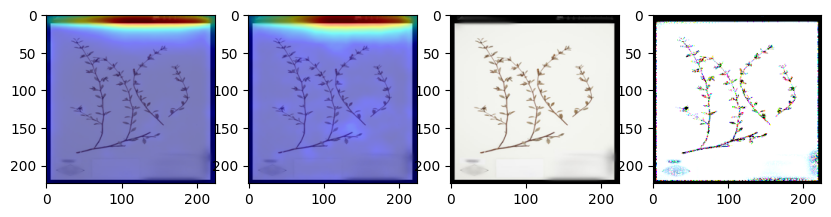

real class name:  Comolia lythrarioides Naudin
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9762285351753235
Mouriri myrtilloides (Sw.) Poir. 0.015159265138208866
--------------------------------


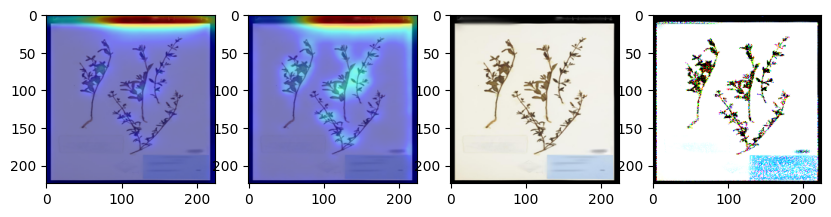

real class name:  Comolia lythrarioides Naudin
image 00002.jpg Detecting for class Centradenia inaequilateralis (Schltdl. & Cham.) G.Don by model resnet50
-
Centradenia inaequilateralis (Schltdl. & Cham.) G.Don 0.9935584664344788
Comolia lythrarioides Naudin 0.006413029972463846
--------------------------------


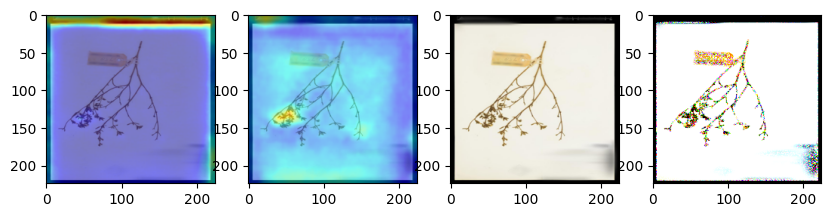

real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.6083100438117981
Macairea parvifolia Benth. 0.23407773673534393
--------------------------------


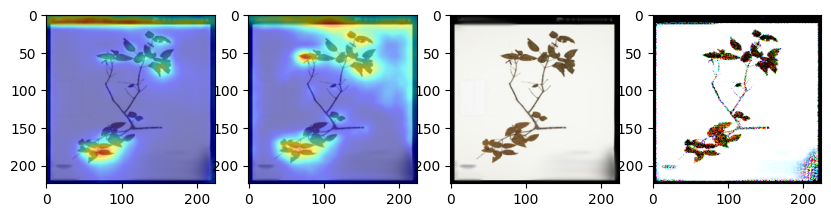

real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.4804598391056061
Mouriri myrtilloides (Sw.) Poir. 0.33081820607185364
--------------------------------


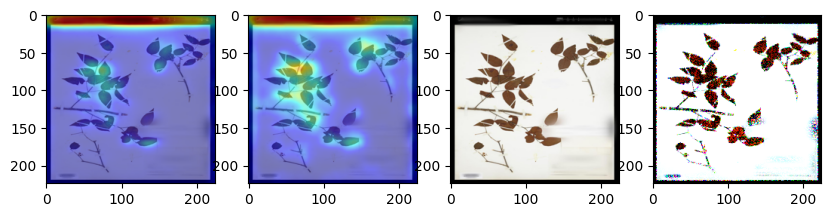

real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00002.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9869266152381897
Mouriri myrtilloides (Sw.) Poir. 0.012463685125112534
--------------------------------


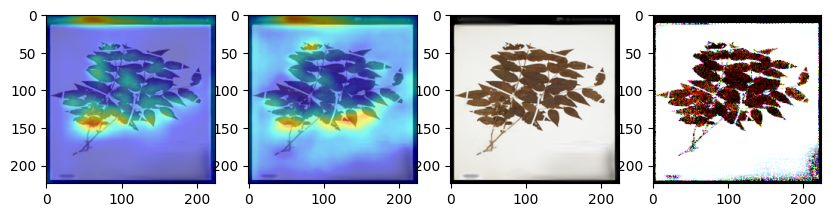

real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00003.jpg Detecting for class Macairea parvifolia Benth. by model resnet50
-
Macairea parvifolia Benth. 0.7913510799407959
Miconia racemosa (Aubl.) DC. 0.14709964394569397
--------------------------------


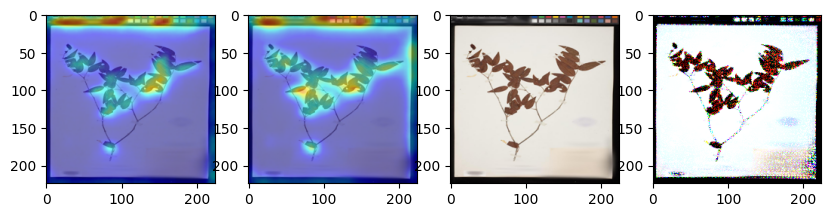

real class name:  Mouriri myrtilloides (Sw.) Poir.
image 00004.jpg Detecting for class Centradenia inaequilateralis (Schltdl. & Cham.) G.Don by model resnet50
-
Centradenia inaequilateralis (Schltdl. & Cham.) G.Don 0.9433318972587585
Macairea parvifolia Benth. 0.029638437554240227
--------------------------------


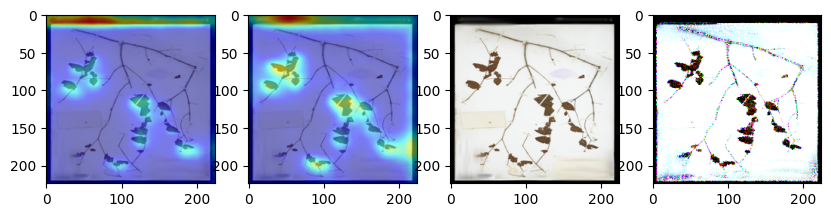

real class name:  Miconia corymbiformis Cogn.
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.3878294825553894
Miconia ibaguensis (Bonpl.) Triana 0.334452360868454
--------------------------------


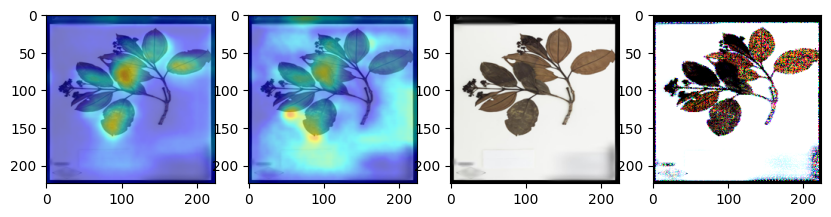

real class name:  Miconia corymbiformis Cogn.
image 00001.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.36835554242134094
Clidemia bullosa DC. 0.267797589302063
--------------------------------


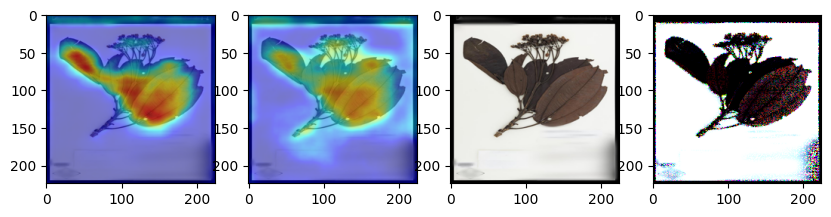

real class name:  Miconia corymbiformis Cogn.
image 00002.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.757301390171051
Miconia ibaguensis (Bonpl.) Triana 0.10459926724433899
--------------------------------


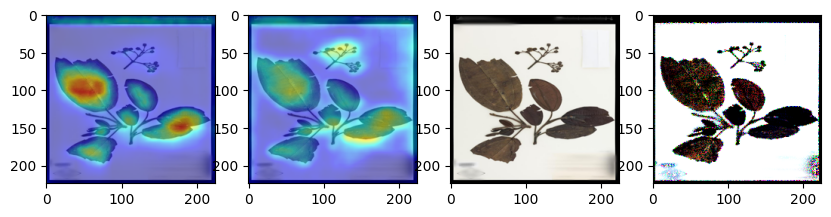

real class name:  Macairea parvifolia Benth.
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9886732697486877
Mouriri myrtilloides (Sw.) Poir. 0.010949826799333096
--------------------------------


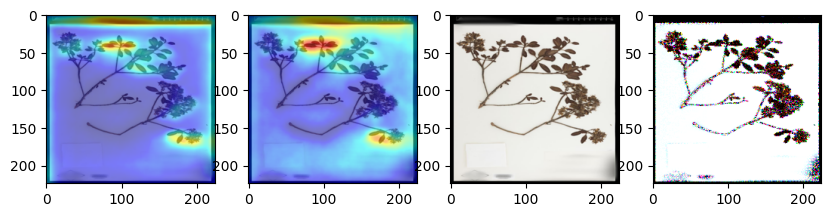

real class name:  Macairea parvifolia Benth.
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9391140341758728
Mouriri myrtilloides (Sw.) Poir. 0.036507003009319305
--------------------------------


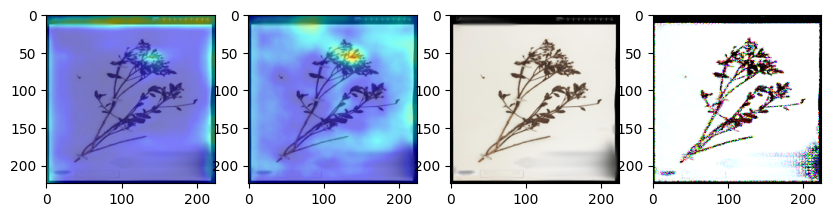

real class name:  Brachyotum strigosum (L.f.) Triana
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9096920490264893
Macairea parvifolia Benth. 0.07440628111362457
--------------------------------


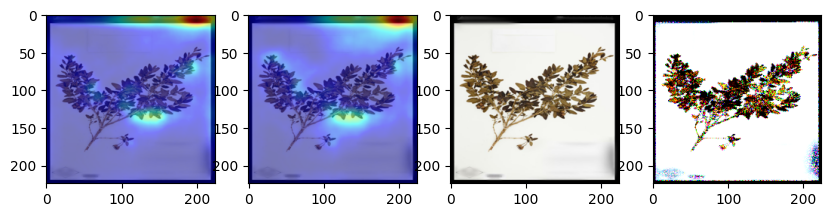

real class name:  Brachyotum strigosum (L.f.) Triana
image 00001.jpg Detecting for class Centradenia inaequilateralis (Schltdl. & Cham.) G.Don by model resnet50
-
Centradenia inaequilateralis (Schltdl. & Cham.) G.Don 0.8615984916687012
Comolia lythrarioides Naudin 0.1379082202911377
--------------------------------


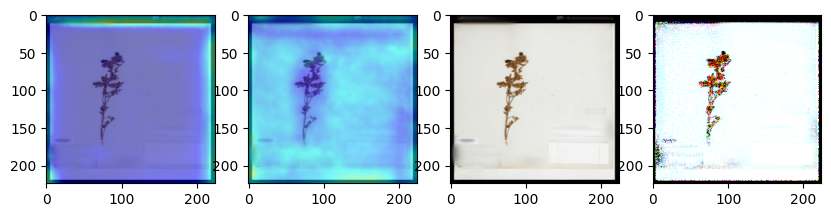

real class name:  Clidemia bullosa DC.
image 00000.jpg Detecting for class Macairea parvifolia Benth. by model resnet50
-
Macairea parvifolia Benth. 0.964094877243042
Miconia racemosa (Aubl.) DC. 0.027102293446660042
--------------------------------


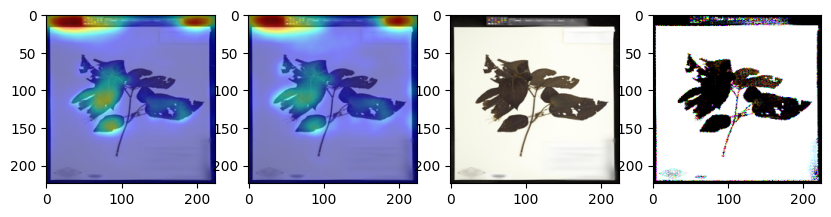

real class name:  Clidemia bullosa DC.
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9875794053077698
Mouriri myrtilloides (Sw.) Poir. 0.012419371865689754
--------------------------------


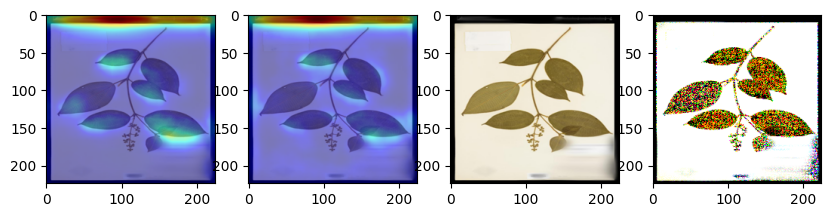

real class name:  Clidemia bullosa DC.
image 00002.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.985352098941803
Mouriri myrtilloides (Sw.) Poir. 0.008641263470053673
--------------------------------


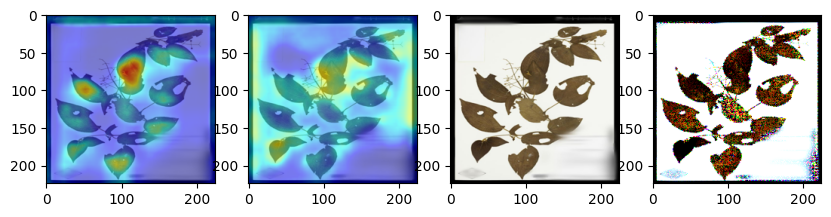

real class name:  Clidemia bullosa DC.
image 00003.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9152839183807373
Macairea parvifolia Benth. 0.07824475318193436
--------------------------------


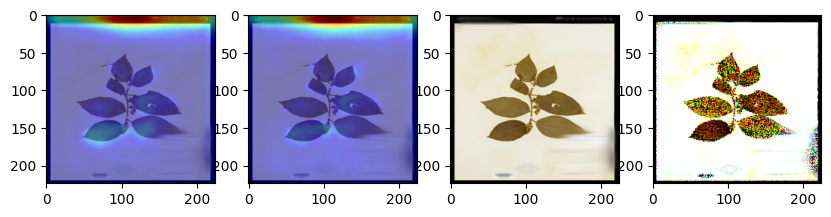

real class name:  Clidemia bullosa DC.
image 00004.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.6382184624671936
Macairea parvifolia Benth. 0.3158106207847595
--------------------------------


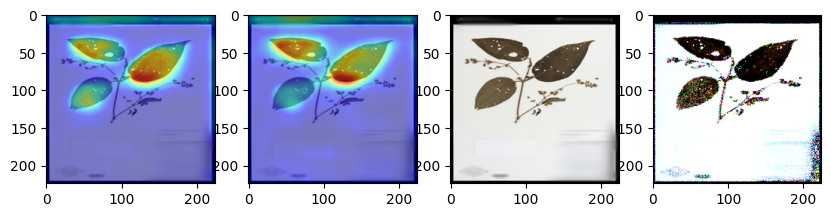

real class name:  Clidemia bullosa DC.
image 00005.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.7375605702400208
Mouriri myrtilloides (Sw.) Poir. 0.21555109322071075
--------------------------------


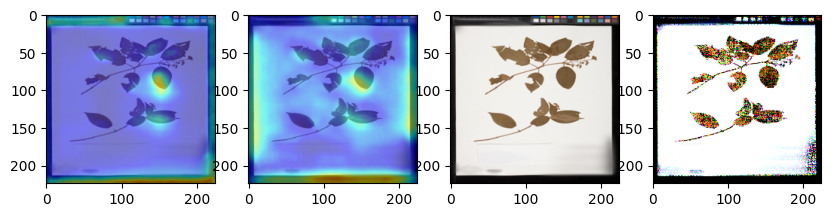

real class name:  Mouriri sagotiana Triana
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.5082307457923889
Graffenrieda harlingii Wurdack 0.12638822197914124
--------------------------------


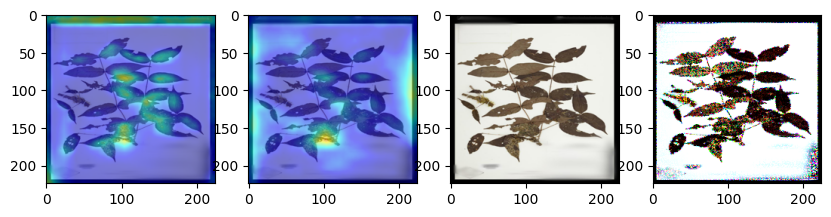

real class name:  Mouriri sagotiana Triana
image 00001.jpg Detecting for class Centradenia inaequilateralis (Schltdl. & Cham.) G.Don by model resnet50
-
Centradenia inaequilateralis (Schltdl. & Cham.) G.Don 0.9411025643348694
Comolia lythrarioides Naudin 0.021900245919823647
--------------------------------


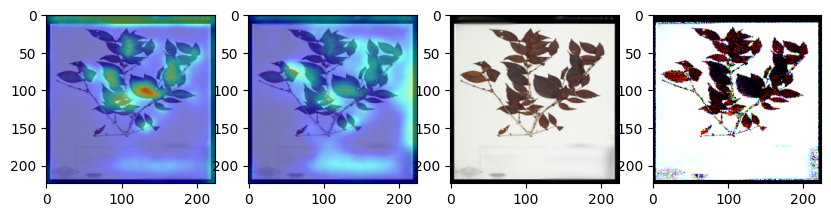

real class name:  Blakea henripittieri (Cogn.) Penneys & Almeda
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9944625496864319
Mouriri myrtilloides (Sw.) Poir. 0.0055372510105371475
--------------------------------


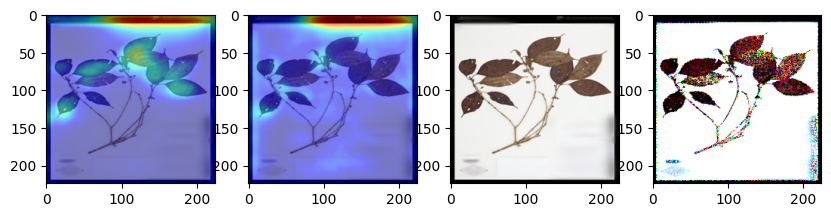

real class name:  Blakea henripittieri (Cogn.) Penneys & Almeda
image 00001.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.5086817741394043
Miconia racemosa (Aubl.) DC. 0.49058857560157776
--------------------------------


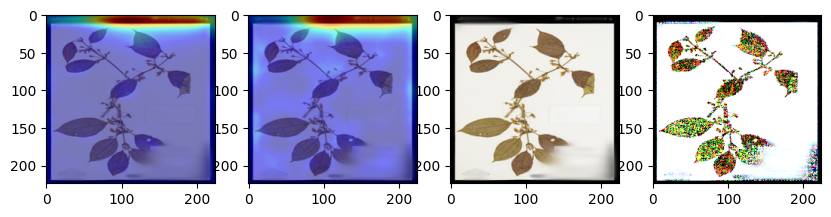

real class name:  Blakea henripittieri (Cogn.) Penneys & Almeda
image 00002.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.6907155513763428
Mouriri myrtilloides (Sw.) Poir. 0.30928441882133484
--------------------------------


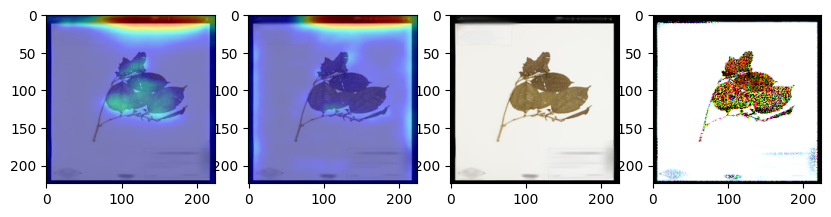

real class name:  Blakea henripittieri (Cogn.) Penneys & Almeda
image 00003.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.3654754161834717
Miconia ibaguensis (Bonpl.) Triana 0.1692611426115036
--------------------------------


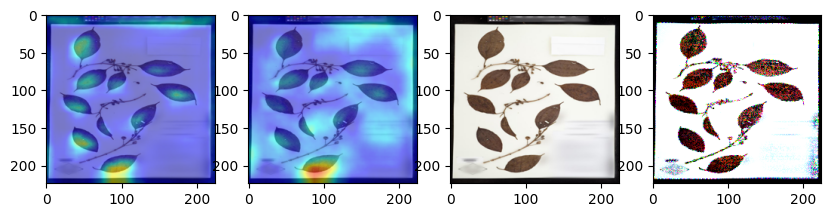

real class name:  Clidemia debilis Crueg.
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.6335671544075012
Macairea parvifolia Benth. 0.3514186143875122
--------------------------------


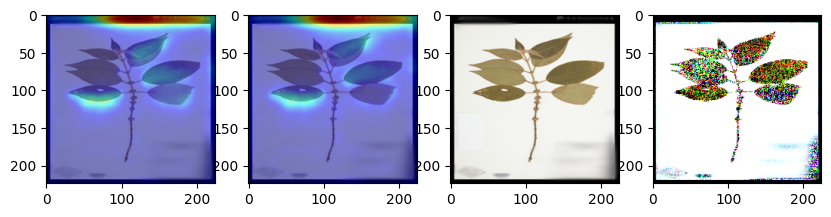

real class name:  Clidemia debilis Crueg.
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.8976607322692871
Mouriri myrtilloides (Sw.) Poir. 0.1022527813911438
--------------------------------


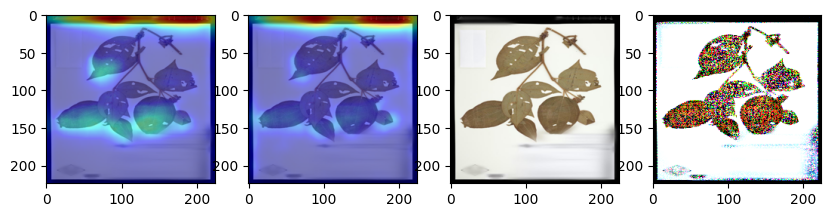

real class name:  Comolia veronicaefolia Benth.
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.64446622133255
Centradenia inaequilateralis (Schltdl. & Cham.) G.Don 0.2259589582681656
--------------------------------


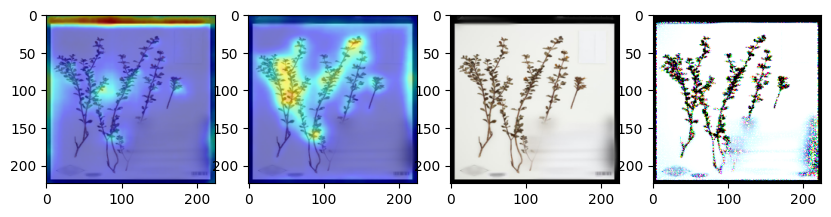

real class name:  Comolia veronicaefolia Benth.
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9971833825111389
Mouriri myrtilloides (Sw.) Poir. 0.0028044325299561024
--------------------------------


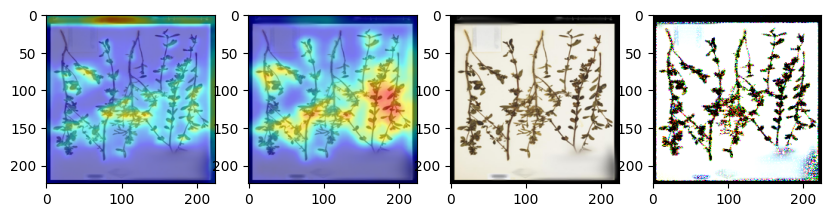

real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00000.jpg Detecting for class Centradenia inaequilateralis (Schltdl. & Cham.) G.Don by model resnet50
-
Centradenia inaequilateralis (Schltdl. & Cham.) G.Don 0.9829277396202087
Comolia lythrarioides Naudin 0.00840010866522789
--------------------------------
real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.6160410046577454
Macairea parvifolia Benth. 0.37023404240608215
--------------------------------


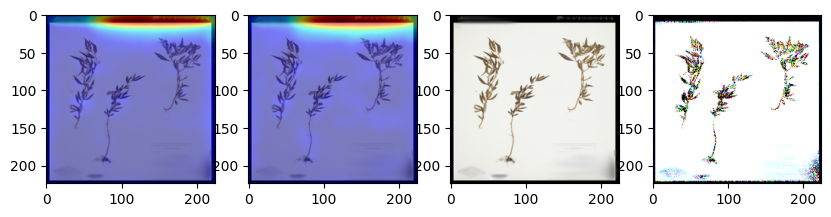

real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00002.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9104115962982178
Macairea parvifolia Benth. 0.02939671277999878
--------------------------------


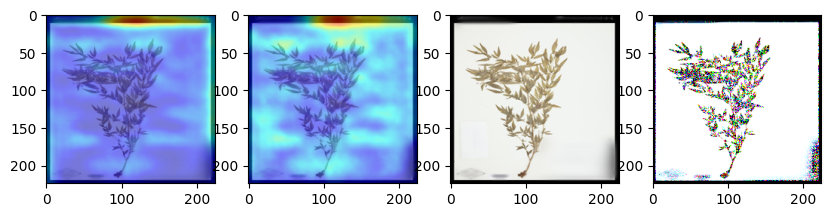

real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00003.jpg Detecting for class Macairea parvifolia Benth. by model resnet50
-
Macairea parvifolia Benth. 0.9426177740097046
Miconia racemosa (Aubl.) DC. 0.055086296051740646
--------------------------------


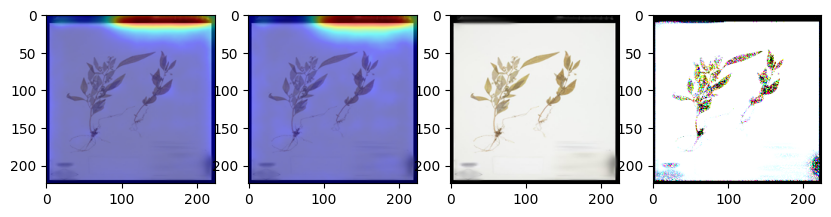

real class name:  Centradenia inaequilateralis (Schltdl. & Cham.) G.Don
image 00004.jpg Detecting for class Centradenia inaequilateralis (Schltdl. & Cham.) G.Don by model resnet50
-
Centradenia inaequilateralis (Schltdl. & Cham.) G.Don 0.9372383952140808
Comolia lythrarioides Naudin 0.0614512637257576
--------------------------------
real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9939829707145691
Mouriri myrtilloides (Sw.) Poir. 0.004069641698151827
--------------------------------


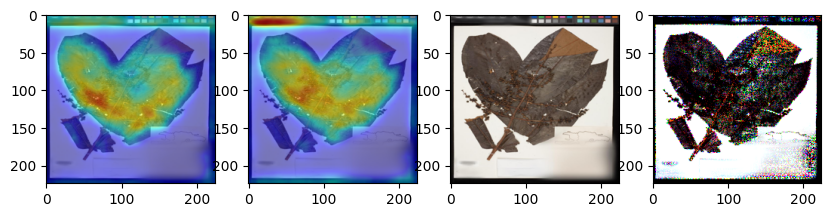

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00001.jpg Detecting for class Centradenia inaequilateralis (Schltdl. & Cham.) G.Don by model resnet50
-
Centradenia inaequilateralis (Schltdl. & Cham.) G.Don 0.9787911176681519
Macairea parvifolia Benth. 0.02072608470916748
--------------------------------


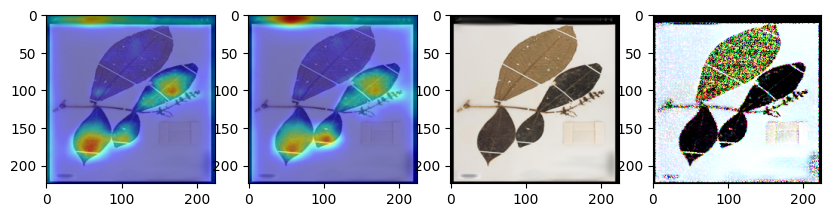

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00002.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.7348324060440063
Clidemia bullosa DC. 0.13160867989063263
--------------------------------


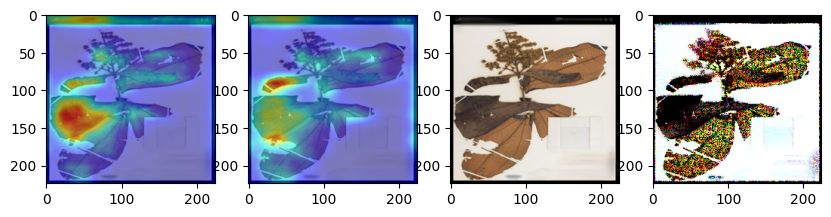

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00003.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9891757369041443
Mouriri myrtilloides (Sw.) Poir. 0.010798408649861813
--------------------------------


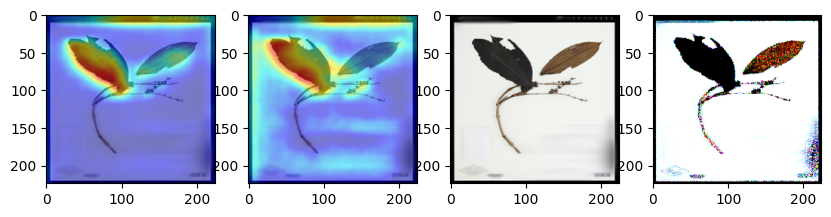

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00004.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9949855804443359
Mouriri myrtilloides (Sw.) Poir. 0.0037039639428257942
--------------------------------


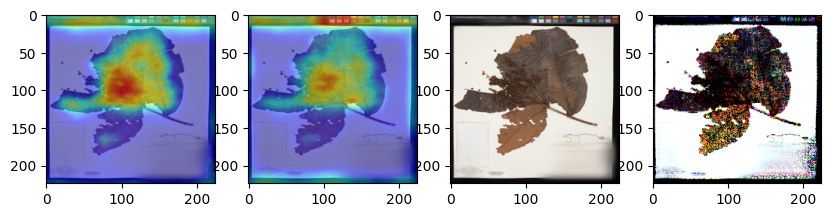

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00005.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.617497980594635
Miconia racemosa (Aubl.) DC. 0.38238126039505005
--------------------------------


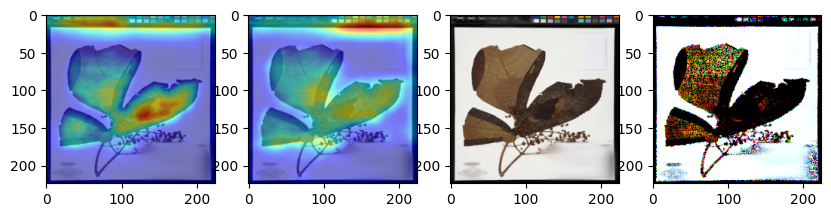

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00006.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.4715789258480072
Clidemia bullosa DC. 0.28837352991104126
--------------------------------


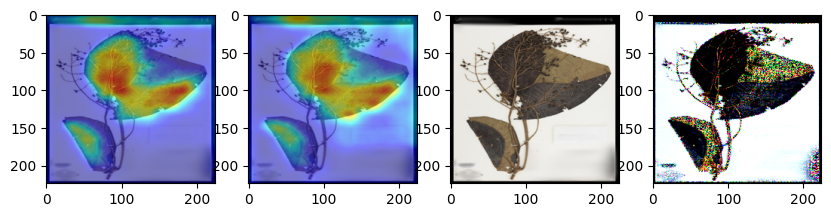

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00007.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9856589436531067
Miconia impetiolaris (Sw.) D.Don ex DC. 0.014248428866267204
--------------------------------


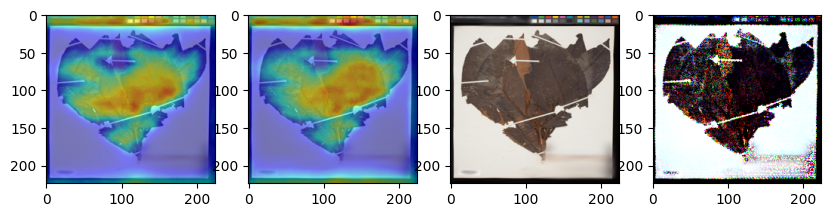

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00008.jpg Detecting for class Miconia corymbiformis Cogn. by model resnet50
-
Miconia corymbiformis Cogn. 0.4486503303050995
Clidemia bullosa DC. 0.2541361153125763
--------------------------------


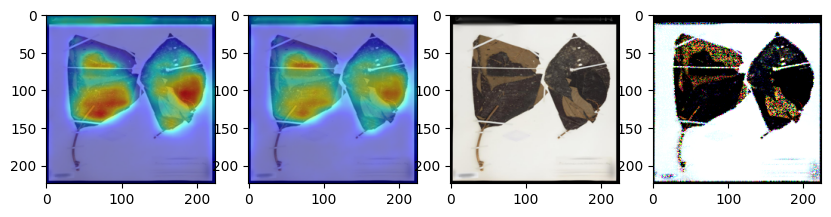

real class name:  Miconia impetiolaris (Sw.) D.Don ex DC.
image 00009.jpg Detecting for class Centradenia inaequilateralis (Schltdl. & Cham.) G.Don by model resnet50
-
Centradenia inaequilateralis (Schltdl. & Cham.) G.Don 0.7653229236602783
Comolia lythrarioides Naudin 0.22598081827163696
--------------------------------


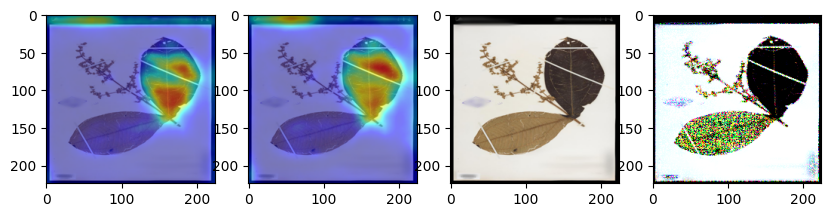

real class name:  Graffenrieda harlingii Wurdack
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.3495146632194519
Clidemia bullosa DC. 0.15510869026184082
--------------------------------


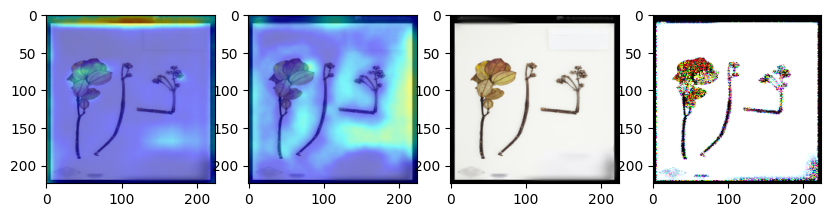

real class name:  Graffenrieda harlingii Wurdack
image 00001.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9674784541130066
Mouriri myrtilloides (Sw.) Poir. 0.01573718711733818
--------------------------------


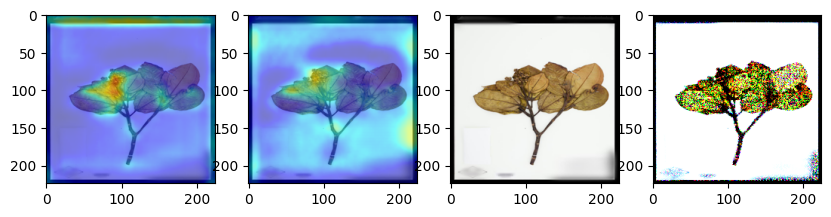

real class name:  Tibouchina ciliaris (Vent.) Cogn.
image 00000.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.68857741355896
Macairea parvifolia Benth. 0.29069244861602783
--------------------------------


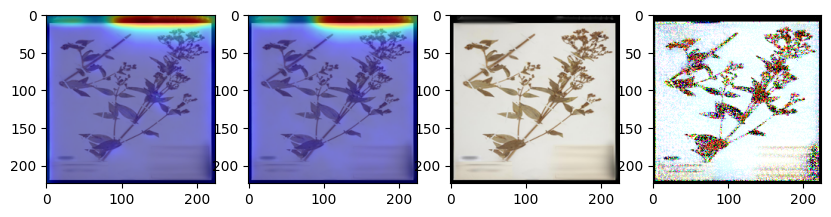

real class name:  Tibouchina ciliaris (Vent.) Cogn.
image 00001.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.7567586898803711
Miconia racemosa (Aubl.) DC. 0.20083189010620117
--------------------------------


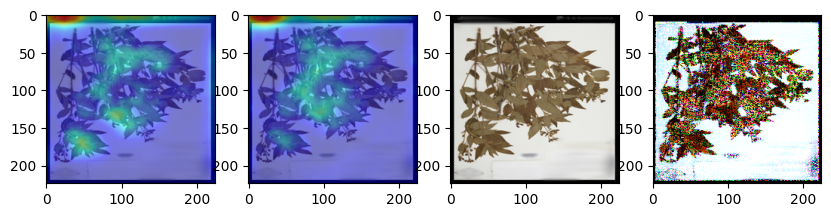

real class name:  Tibouchina ciliaris (Vent.) Cogn.
image 00002.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9967390894889832
Mouriri myrtilloides (Sw.) Poir. 0.002999493619427085
--------------------------------


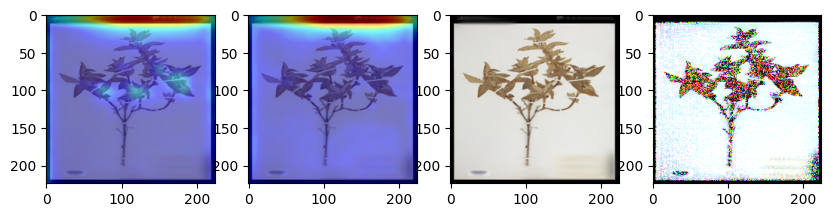

real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00000.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.9269647002220154
Miconia racemosa (Aubl.) DC. 0.07301543653011322
--------------------------------


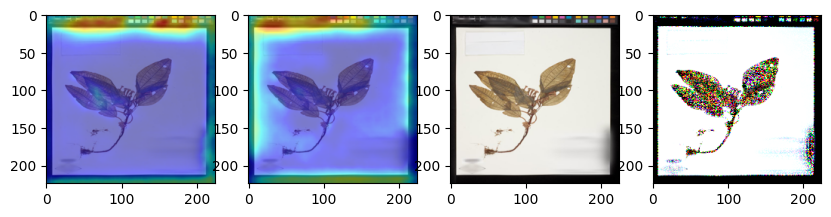

real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00001.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.9003974795341492
Miconia racemosa (Aubl.) DC. 0.09959835559129715
--------------------------------


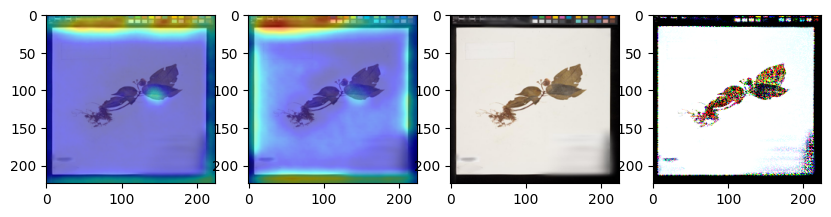

real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00002.jpg Detecting for class Mouriri myrtilloides (Sw.) Poir. by model resnet50
-
Mouriri myrtilloides (Sw.) Poir. 0.8603336215019226
Miconia racemosa (Aubl.) DC. 0.13960857689380646
--------------------------------


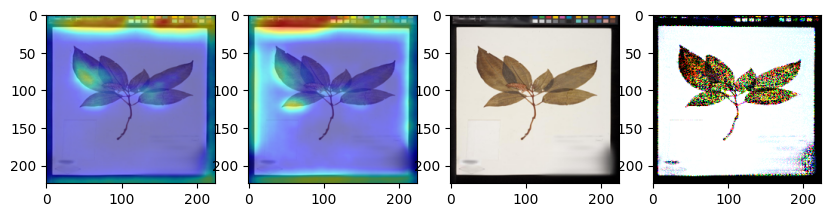

real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00003.jpg Detecting for class Miconia racemosa (Aubl.) DC. by model resnet50
-
Miconia racemosa (Aubl.) DC. 0.9478466510772705
Mouriri myrtilloides (Sw.) Poir. 0.02495122142136097
--------------------------------


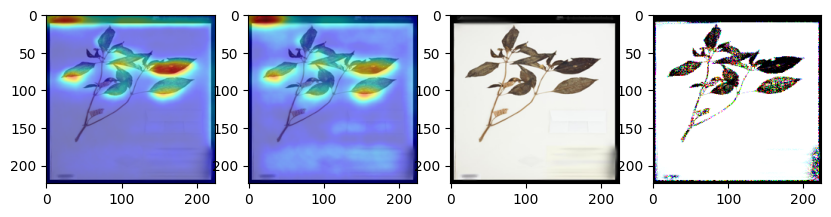

real class name:  Salpinga secunda Schrank & Mart. ex DC.
image 00004.jpg Detecting for class Miconia ibaguensis (Bonpl.) Triana by model resnet50
-
Miconia ibaguensis (Bonpl.) Triana 0.5678749680519104
Miconia racemosa (Aubl.) DC. 0.35249871015548706
--------------------------------


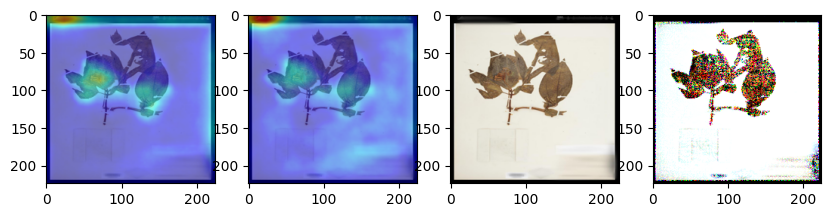

In [39]:
# Load the images
#/content/drive/MyDrive/Model Data/test-images


resize_size =(224,224)
#path = "cnn/saved_models/" +path
resize_to = transforms.Resize((227, 227))
#model.load_state_dict(torch.load(path))
model.eval()
directory = '/content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation'

# use os.listdir() to get a list of all files in the directory
files = os.listdir(directory)
for filename in files:
  #print(filename)
  img_files = os.listdir('//content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation/'+filename)
  for img_file in img_files:
    #print(img_file)
    input_image = Image.open('/content/drive/MyDrive/Hebarium-Data-2019/Data/sample/validation/'+filename+"/"+img_file)
    
    preprocess = transforms.Compose(
          [
              resize_to,
              transforms.CenterCrop(224),
              transforms.ToTensor(),
              transforms.Normalize(
                  mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
              ),  # IMPORTANT: normalize for pretrained models
          ]
    )
    input_tensor = preprocess(input_image)
    #input_batch = input_tensor.unsqueeze(0)  # create a mini-batch as expected by the model

    #input_tensor = preprocess(input_image)
    input_batch = input_tensor.unsqueeze(0).numpy().astype(np.float32)

    #input_batch = input_batch[0].transpose((1,2,0))


    input_batch2 = torch.from_numpy(input_batch)
    
    input_batch3 = input_batch2.numpy()
    
    fgsm_attack = FastGradientMethod(estimator = classifier, eps=0.9) 

    x_test_adv = fgsm_attack.generate(x=input_batch3)
    x_test_adv2 = torch.from_numpy(x_test_adv)
    x_test_adv3 = x_test_adv.squeeze(0)



    # move the input and model to GPU for speed if available
    if torch.cuda.is_available():
      x_test_adv2 = x_test_adv2.to("cuda")
      model.to("cuda")

    with torch.no_grad():
        output = model(x_test_adv2)

    # The output has unnormalized scores. To get probabilities, you can run a softmax on it.
    probabilities = torch.nn.functional.softmax(output[0], dim=0)
    x , y = torch.topk(probabilities, 1) 
    print("real class name: ", foldername_to_class[str(filename)])
    print(f"image {img_file} Detecting for class {categories[y]} by model {modelname}")
    print("-")
    # Show top categories per image

    top5_prob, top5_catid = torch.topk(probabilities, 2)
    for i in range(top5_prob.size(0)):
        print(categories[top5_catid[i]], top5_prob[i].item())

    print("--------------------------------")

    #print("this")
    if categories[y] != foldername_to_class[filename]:
      
      targets0 = [ClassifierOutputTarget(0)] #0 for finch ?
      targets1 = [ClassifierOutputTarget(1)]

      # You can also pass aug_smooth=True and eigen_smooth=True, to apply smoothing.
      grayscale_cam0 = cam(x_test_adv2, targets=targets0,aug_smooth=True)
      grayscale_cam1 = cam(x_test_adv2, targets=targets1,aug_smooth=True)

      # In this example grayscale_cam has only one image in the batch:
      grayscale_cam0 = grayscale_cam0[0, :]
      grayscale_cam1 = grayscale_cam1[0, :]


      img=np.array(input_image.resize(resize_size),np.float32)
      img = img.reshape(img.shape[1],img.shape[0],img.shape[2])

      img = img/255
      visualization0 = show_cam_on_image(img, grayscale_cam0, use_rgb=True)
      visualization1 = show_cam_on_image(img, grayscale_cam1, use_rgb=True)

      visualization0 = Image.fromarray(visualization0)
      visualization1 = Image.fromarray(visualization1)
    

      # fig, ax = plt.subplots(1, 4)
      # ax[0].imshow(visualization0, cmap='gray')
      # ax[1].imshow(visualization1, cmap='gray')
      # ax[2].imshow(input_image.resize(resize_size), cmap='gray')
      # ax[3].imshow(x_test_adv3.transpose((1,2,0)), cmap='gray')
      #ax[3].imshow(np.resize(x_test_adv2.cpu(), resize_size), cmap='gray')
      




      fig, ax = plt.subplots(1, 4, figsize=(10, 4))

     # Set the aspect ratio of the images to 'equal'
      for i in range(4):
         ax[i].set_aspect('equal')

        # Plot the images on the subplots
      ax[0].imshow(visualization0, cmap='gray')
      ax[1].imshow(visualization1, cmap='gray')
      ax[2].imshow(input_image.resize(resize_size), cmap='gray')
      ax[3].imshow(x_test_adv3.transpose((1,2,0)), cmap='gray')

      # Show the plot
      plt.show()
    


## final GradCAM Analysis:

Using Grad-CAM (Gradient-weighted Class Activation Mapping) is a great way to visualize which regions of an input image were most important for a model's classification decision. By plotting the heatmap generated by the Grad-CAM method on top of the input image, you can see which parts of the image the model paid attention to when making its prediction.

When you are reviewing the test images and their corresponding heatmaps, you can check the score calculated by the model for each class, and try to understand how the model arrived at its decision by looking at the regions of the image highlighted by the heatmap. For example, if the model predicted that a given image is of a dog, and the heatmap shows that the model paid attention to the ears and nose of the animal, it's likely that the model has learned to recognize those features as indicative of a dog.

In addition, by using the Gerdcam method, the heatmap will be specific to the class that the image was predicted to be, so it will be more interpretable in terms of understanding the image feature that the model used to classify that specific class.

It's important to note that the heatmap generated by Grad-CAM is an approximate representation of the model's attention and it's not intended to be a definitive explanation of the model's decision-making process. But it can be used as a tool to gain insights into a model's behavior, and to identify areas for improvement in the training data or model architecture.





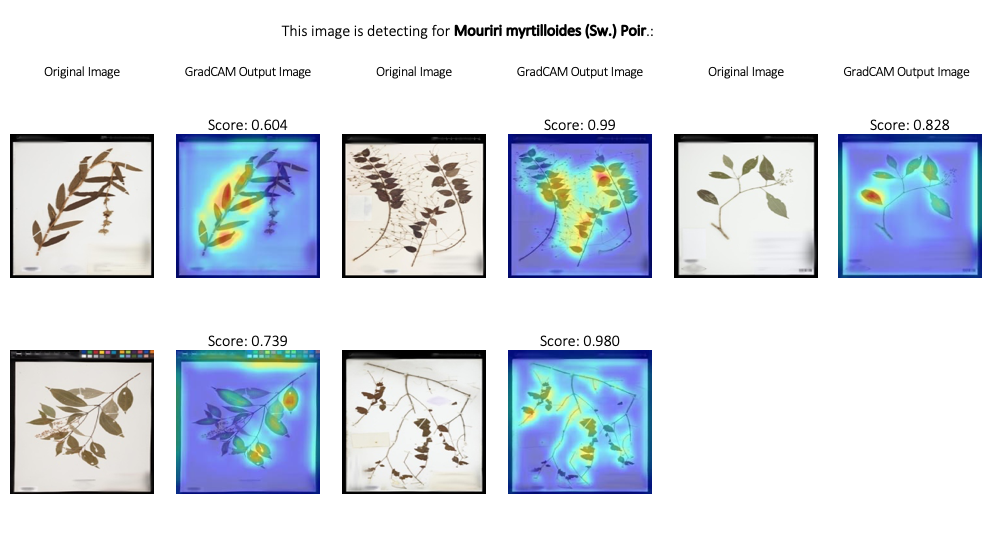

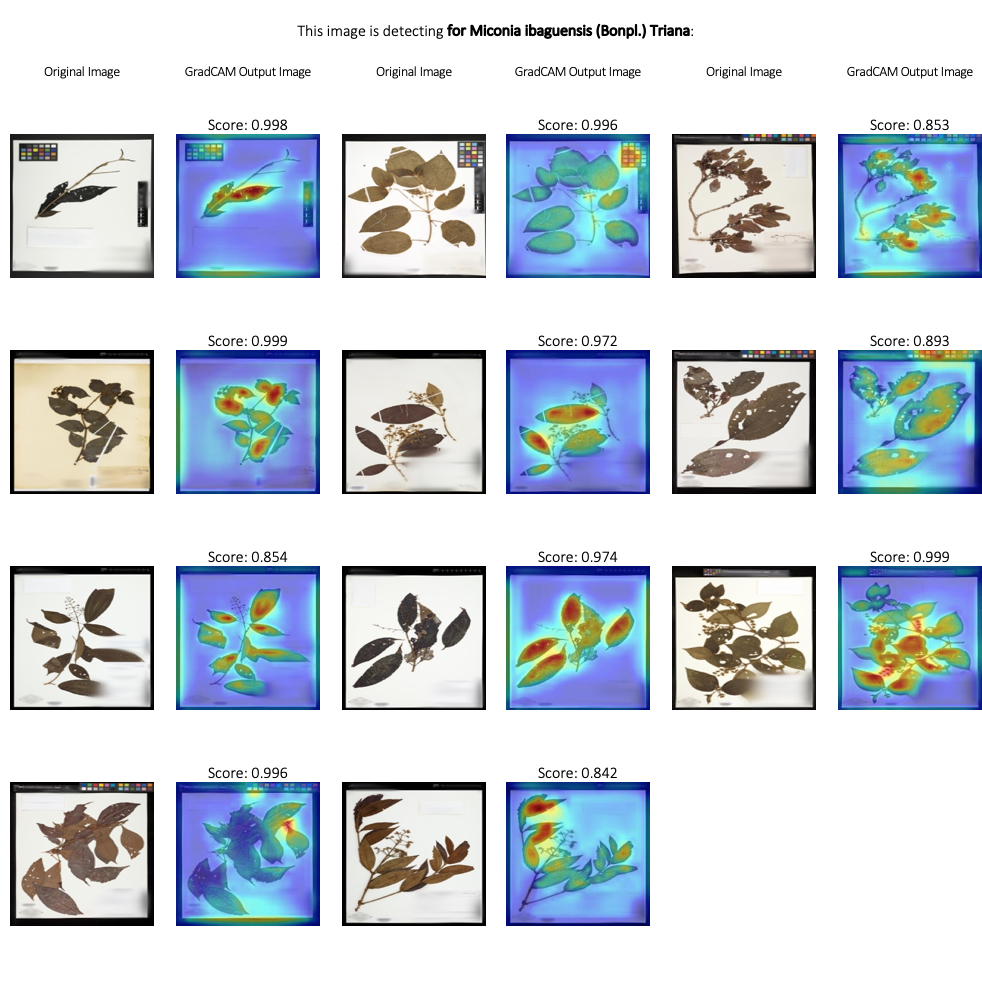

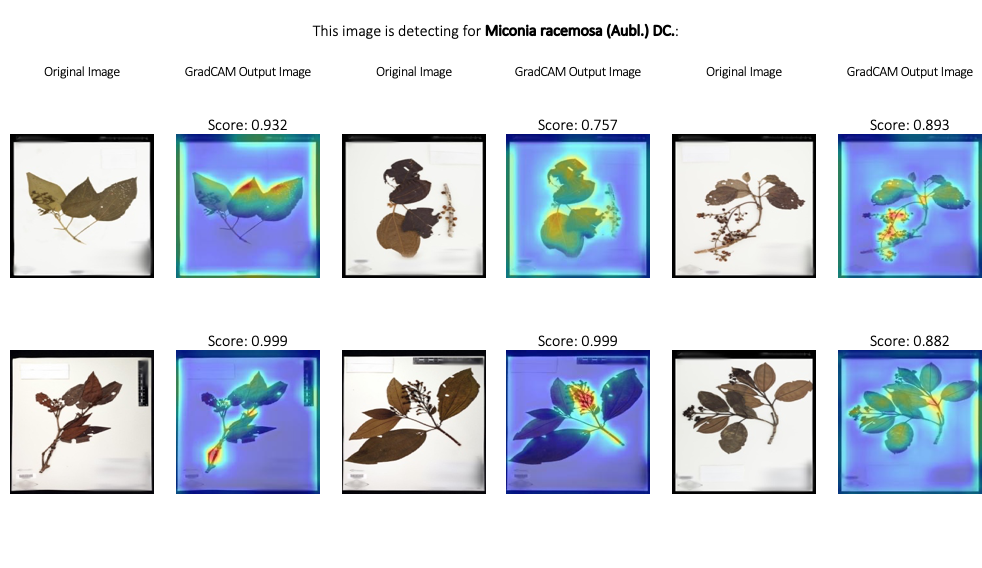

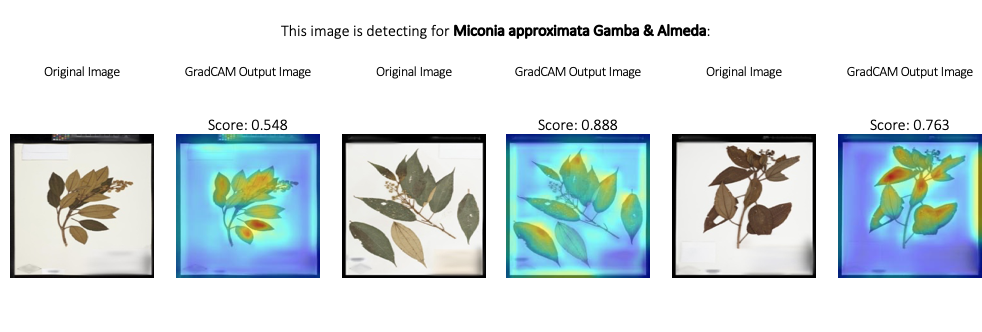

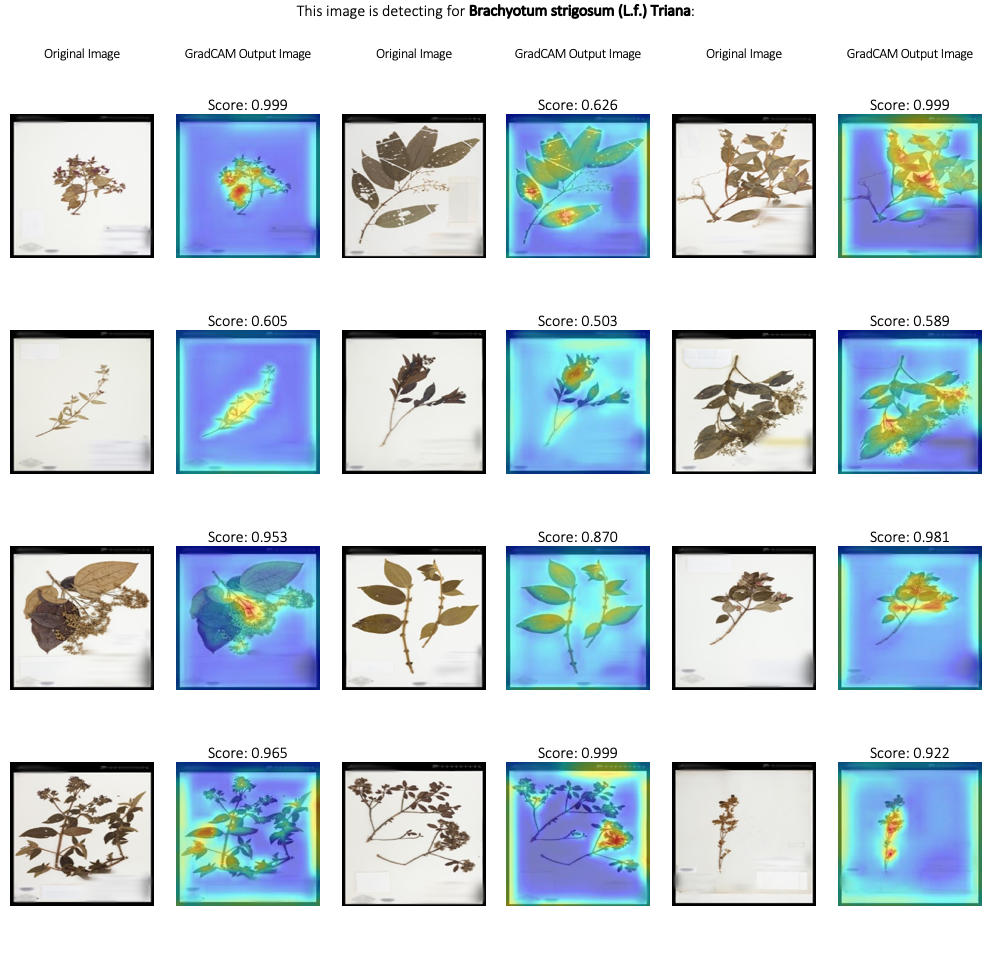

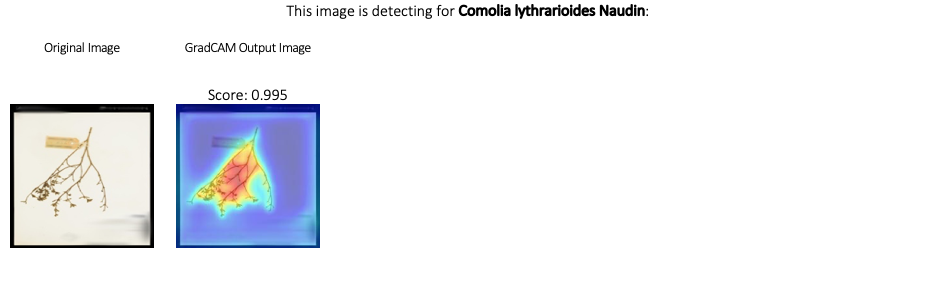

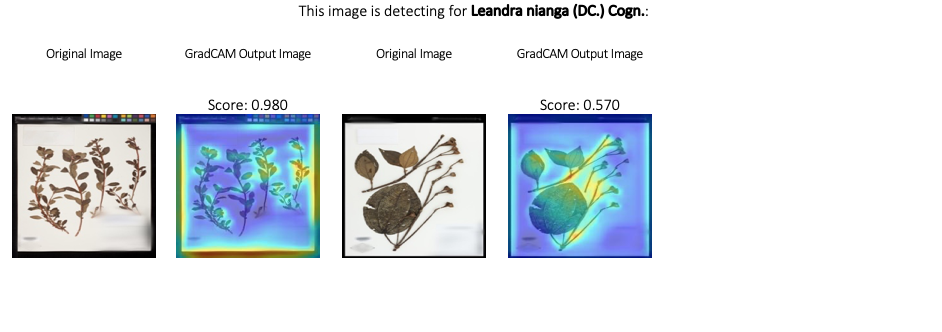